# Spectrally Normalized Generative Adversarial Networks (SN-GAN)

*Please note that this is an optional notebook, meant to introduce more advanced concepts if you're up for a challenge, so don't worry if you don't completely follow!*

**Goals**

In this notebook, you'll learn about and implement **spectral normalization**, a weight normalization technique to stabilize the training of the discriminator, as proposed in [Spectral Normalization for Generative Adversarial Networks](https://arxiv.org/abs/1802.05957) (Miyato et al. 2018).

**Background**

As its name suggests, SN-GAN normalizes the weight matrices in the discriminator by their corresponding [spectral norm](https://calculus.subwiki.org/wiki/Spectral_norm#:~:text=The%20spectral%20norm%20of%20a,where%20denotes%20the%20Euclidean%20norm.), which helps control the Lipschitz constant of the discriminator. As you have learned with WGAN, [Lipschitz continuity](https://en.wikipedia.org/wiki/Lipschitz_continuity) is important in ensuring the boundedness of the optimal discriminator. In the WGAN case, this makes it so that the underlying W-loss function for the discriminator (or more precisely, the critic) is valid.

As a result, spectral normalization helps improve stability and avoid vanishing gradient problems, such as mode collapse.

## Spectral Norm

Notationally, the spectral norm of a matrix $W$ is typically represented as $\sigma(W)$. For neural network purposes, this $W$ matrix represents a weight matrix in one of the network's layers. The spectral norm of a matrix is the matrix's largest singular value, which can be obtained via singular value decomposition (SVD).

**A Quick Refresher on SVD**

SVD is a generalization of [eigendecomposition](https://en.wikipedia.org/wiki/Eigendecomposition_of_a_matrix) and is used to factorize a matrix as $W = U\Sigma V^\top$, where $U, V$ are orthogonal matrices and $\Sigma$ is a matrix of singular values on its diagonal. Note that $\Sigma$ doesn't have to be square.

\begin{align*}
    \Sigma = \begin{bmatrix}\sigma_1 & & \\ & \sigma_2 \\ & & \ddots \\ & & & \sigma_n\end{bmatrix}
\end{align*}

where $\sigma_1$ and $\sigma_n$ are the largest and smallest singular values, respectively. Intuitively, larger values correspond to larger amounts of stretching a matrix can apply to another vector. Following this notation, $\sigma(W) = \sigma_1$.

**Applying SVD to Spectral Normalization**

To spectrally normalize the weight matrix, you divide every value in the matrix by its spectral norm. As a result, a spectrally normalized matrix $\overline{W}_{SN}$ can be expressed as

\begin{align*}
  \overline{W}_{SN} = \dfrac{W}{\sigma(W)},
\end{align*}

In practice, computing the SVD of $W$ is expensive, so the authors of the SN-GAN paper do something very neat. They instead approximate the left and right singular vectors, $\tilde{u}$ and $\tilde{v}$ respectively, through power iteration such that $\sigma(W) \approx \tilde{u}^\top W\tilde{v}$.

Starting from randomly initialization, $\tilde{u}$ and $\tilde{v}$ are updated according to

\begin{align*}
  \tilde{u} &:= \dfrac{W^\top\tilde{u}}{||W^\top\tilde{u}||_2} \\
  \tilde{v} &:= \dfrac{W\tilde{v}}{||W\tilde{v}||_2}
\end{align*}

In practice, one round of iteration is sufficient to "achieve satisfactory performance" as per the authors.

Don't worry if you don't completely follow this! The algorithm is conveniently implemented as `torch.nn.utils.spectral_norm` in PyTorch, so as long as you get the general gist of how it might be useful and when to use it, then you're all set.


## A Bit of History on Spectral Normalization

This isn't the first time that spectral norm has been proposed in the context of deep learning models. There's a paper called [Spectral Norm Regularization for Improving the Generalizability of Deep Learning](https://arxiv.org/abs/1705.10941) (Yoshida et al. 2017) that proposes **spectral norm regularization**, which they showed to improve the generalizability of models by adding extra loss terms onto the loss function (just as L2 regularization and gradient penalty do!). These extra loss terms specifically penalize the spectral norm of the weights. You can think of this as *data-independent* regularization because the gradient with respect to $W$ isn't a function of the minibatch.

**Spectral normalization**, on the other hand, sets the spectral norm of the weight matrices to 1 -- it's a much harder constraint than adding a loss term, which is a form of "soft" regularization. As the authors show in the paper, you can think of spectral normalization as *data-dependent* regularization, since the gradient with respect to $W$ is dependent on the mini-batch statistics (shown in Section 2.1 of the [main paper](https://arxiv.org/pdf/1802.05957.pdf)). Spectral normalization essentially prevents the transformation of each layer
from becoming to sensitive in one direction and mitigates exploding gradients.

## DCGAN with Spectral Normalization

In rest of this notebook, you will walk through how to apply spectral normalization to DCGAN as an example, using your earlier DCGAN implementation. You can always add spectral normalization to your other models too.

Here, you start with the same setup and helper function, as you've seen before. 

In [1]:
# Some setup
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

'''
Function for visualizing images: Given a tensor of images, number of images, and
size per image, plots and prints the images in an uniform grid.
'''
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

### DCGAN Generator

Since spectral normalization is only applied to the matrices in the discriminator, the generator implementation is the same as the original.

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
    z_dim: the dimension of the noise vector, a scalar
    im_chan: the number of channels of the output image, a scalar
            MNIST is black-and-white, so that's our default
    hidden_dim: the inner dimension, a scalar
    '''
    
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of the DCGAN, 
        corresponding to a transposed convolution, a batchnorm (except for in the last layer), and an activation
        Parameters:
        input_channels: how many channels the input feature representation has
        output_channels: how many channels the output feature representation should have
        kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
        stride: the stride of the convolution
        final_layer: whether we're on the final layer (affects activation and batchnorm)
        '''
        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else: # Final Layer
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def unsqueeze_noise(self, noise):
        '''
        Function for completing a forward pass of the Generator: Given a noise vector, 
        returns a copy of that noise with width and height = 1 and channels = z_dim.
        Parameters:
        noise: a noise tensor with dimensions (batch_size, z_dim)
        '''
        return noise.view(len(noise), self.z_dim, 1, 1)

    def forward(self, noise):
        '''
        Function for completing a forward pass of the Generator: Given a noise vector, 
        returns a generated image.
        Parameters:
        noise: a noise tensor with dimensions (batch_size, z_dim)
        '''
        x = self.unsqueeze_noise(noise)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating a noise vector: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
    n_samples: the number of samples in the batch, a scalar
    z_dim: the dimension of the noise vector, a scalar
    device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

### DCGAN Discriminator

For the discriminator, you can wrap each `nn.Conv2d` with `nn.utils.spectral_norm`. In the backend, this introduces parameters for $\tilde{u}$ and $\tilde{v}$ in addition to $W$ so that the $W_{SN}$ can be computed as $\tilde{u}^\top W\tilde{v}$ in runtime.

Pytorch also provides a `nn.utils.remove_spectral_norm` function, which collapses the 3 separate parameters into a single explicit $\overline{W}_{SN} := \tilde{u}^\top W\tilde{v}$. You should only apply this to your convolutional layers during inference to improve runtime speed.

It is important note that spectral norm does not eliminate the need for batch norm. Spectral norm affects the weights of each layer, while batch norm affects the activations of each layer. You can see both in a discriminator architecture, but you can also see just one of them. Hope this is something you have fun experimenting with!

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
    im_chan: the number of channels of the output image, a scalar
            MNIST is black-and-white (1 channel), so that's our default.
    hidden_dim: the inner dimension, a scalar
    '''

    def __init__(self, im_chan=1, hidden_dim=16):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN, 
        corresponding to a convolution, a batchnorm (except for in the last layer), and an activation
        Parameters:
        input_channels: how many channels the input feature representation has
        output_channels: how many channels the output feature representation should have
        kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
        stride: the stride of the convolution
        final_layer: whether we're on the final layer (affects activation and batchnorm)
        '''
        
        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                nn.utils.spectral_norm(nn.Conv2d(input_channels, output_channels, kernel_size, stride)),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else: # Final Layer
            return nn.Sequential(
                nn.utils.spectral_norm(nn.Conv2d(input_channels, output_channels, kernel_size, stride)),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the Discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
        image: a flattened image tensor with dimension (im_dim)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

### Training SN-DCGAN

You can now put everything together and train a spectrally normalized DCGAN! Here are all your parameters for initialization and optimization. 

In [4]:
criterion = nn.BCEWithLogitsLoss() # since we don't have sigmoid as final layer of Discriminator

In [5]:
n_epochs = 150
z_dim = 64
display_step = 500
batch_size = 128
# A learning rate of 0.0002 works well on DCGAN
lr = 0.0002

# These parameters control the optimizer's momentum, which you can read more about here:
# https://distill.pub/2017/momentum/ but you don’t need to worry about it for this course
beta_1 = 0.5 
beta_2 = 0.999
device = 'cuda'

In [6]:
# We tranform our image values to be between -1 and 1 (the range of the tanh activation)
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST(".", download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Now, initialize the generator, the discriminator, and the optimizers.

In [7]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr, betas=(beta_1, beta_2))

In [8]:
# initialize weights to normal distribution mean: 0 & std: 0.02
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

In [9]:
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

In [10]:
print(disc)

Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Conv2d(1, 16, kernel_size=(4, 4), stride=(2, 2))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(16, 32, kernel_size=(4, 4), stride=(2, 2))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(32, 1, kernel_size=(4, 4), stride=(2, 2))
    )
  )
)


In [11]:
print(gen)

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(64, 256, kernel_size=(3, 3), stride=(2, 2))
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(3, 3), stride=(2, 2))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2))
      (1): Tanh()
    )
  )
)


Finally, train the whole thing! And babysit those outputs :)

In [12]:
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 2/150 Step 500 G_loss: 0.693655 D_loss: 0.696784


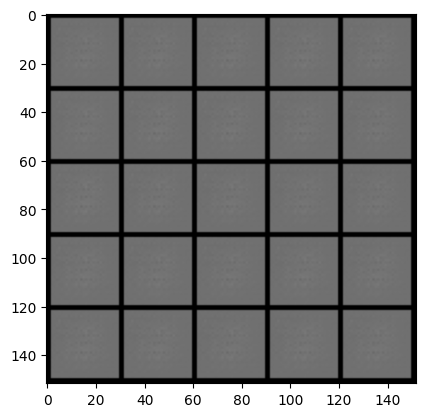

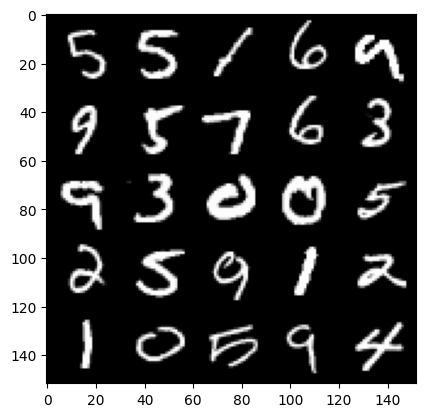

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 3/150 Step 1000 G_loss: 0.693261 D_loss: 0.693199


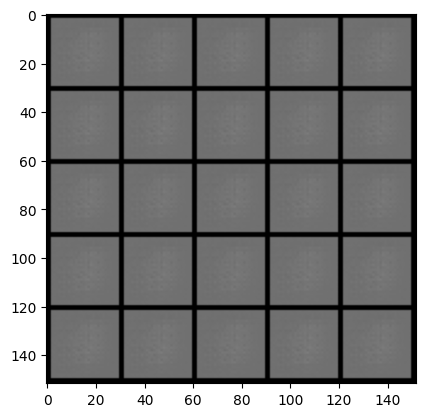

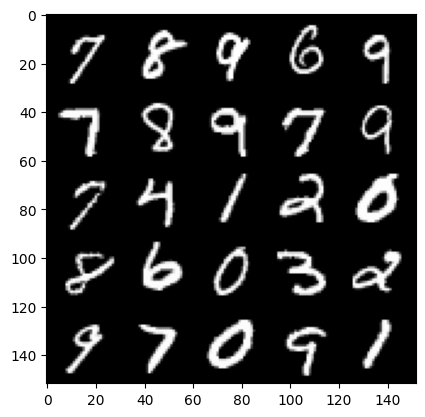

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 4/150 Step 1500 G_loss: 0.693389 D_loss: 0.693195


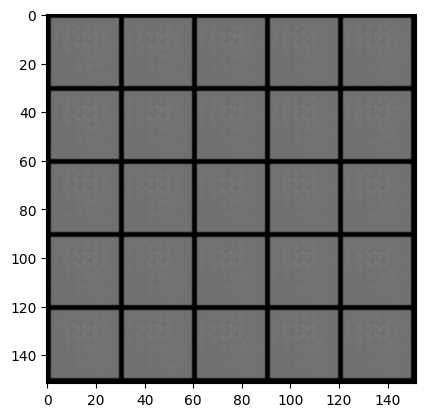

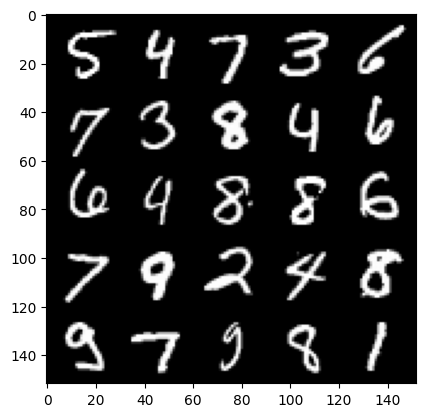

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 5/150 Step 2000 G_loss: 0.693190 D_loss: 0.693190


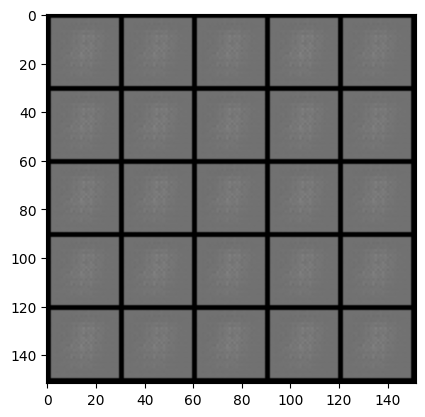

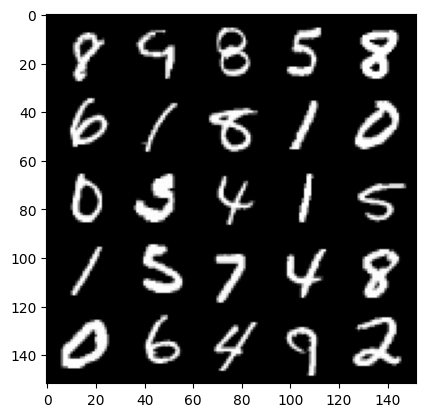

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 6/150 Step 2500 G_loss: 0.693370 D_loss: 0.693230


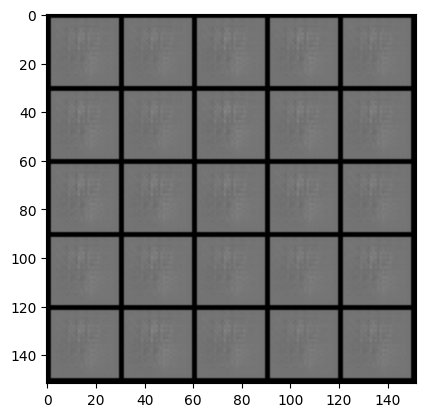

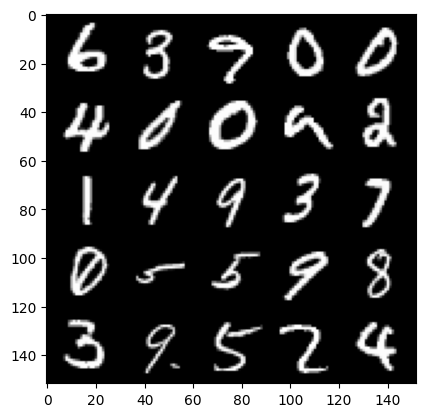

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 7/150 Step 3000 G_loss: 0.693362 D_loss: 0.693186


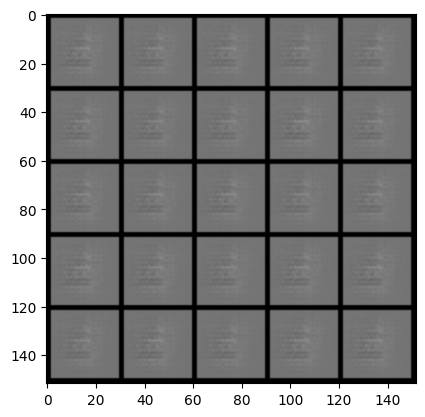

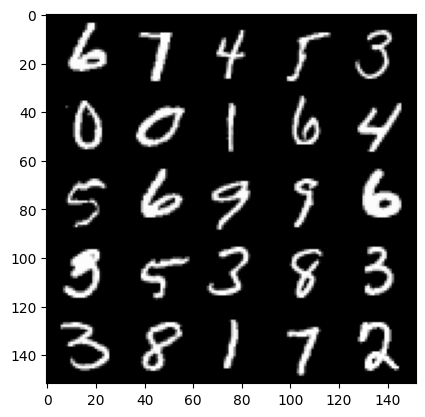

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 8/150 Step 3500 G_loss: 0.693542 D_loss: 0.693234


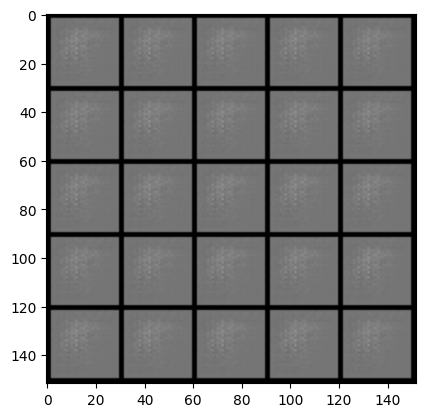

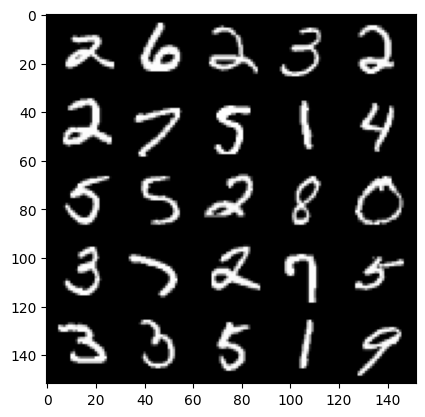

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 9/150 Step 4000 G_loss: 0.693222 D_loss: 0.693191


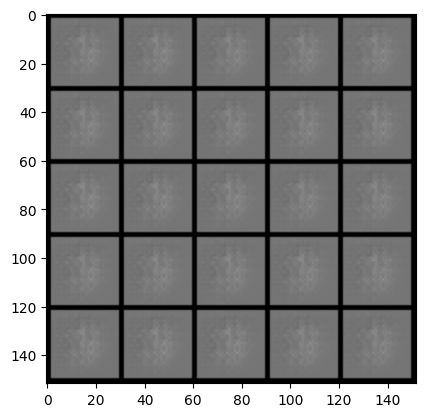

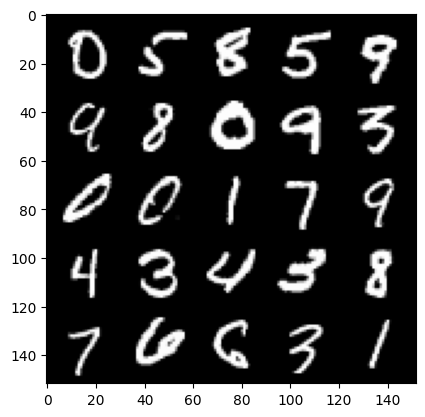

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 10/150 Step 4500 G_loss: 0.693299 D_loss: 0.693176


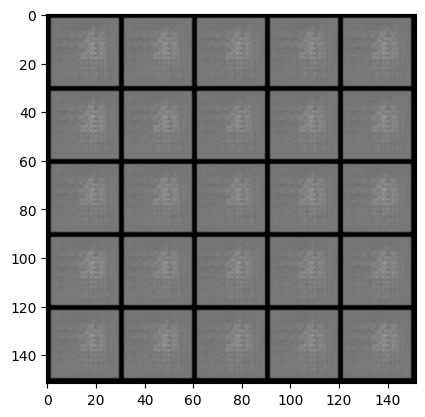

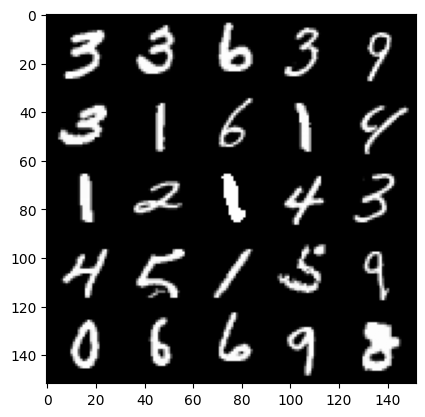

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 11/150 Step 5000 G_loss: 0.693203 D_loss: 0.693163


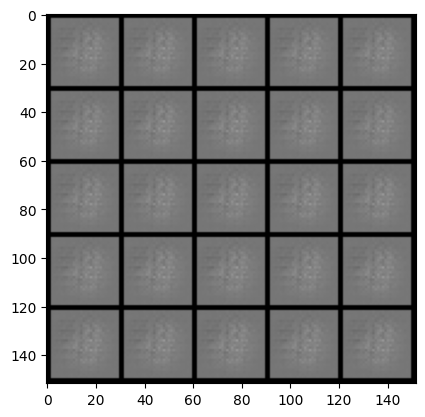

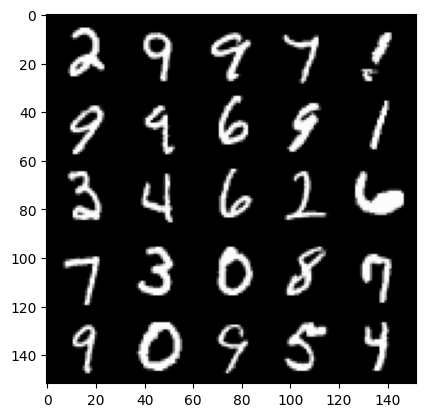

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 12/150 Step 5500 G_loss: 0.693406 D_loss: 0.693203


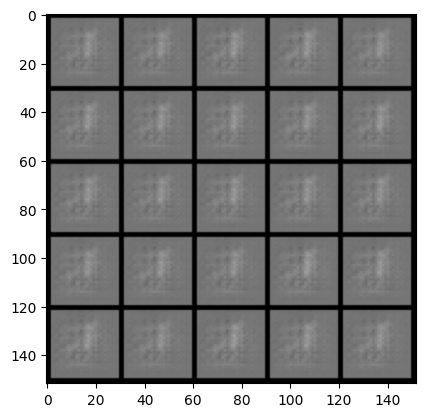

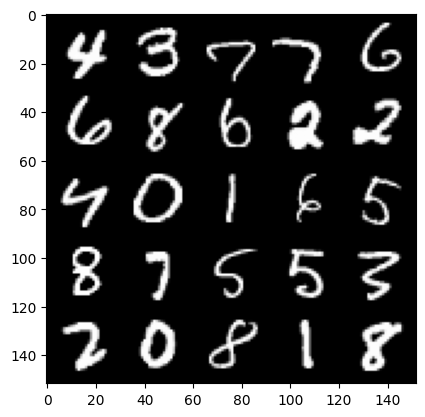

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 13/150 Step 6000 G_loss: 0.693175 D_loss: 0.693158


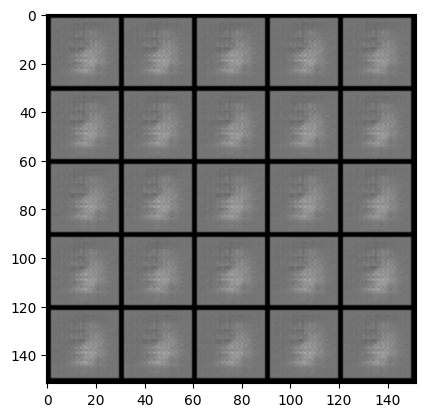

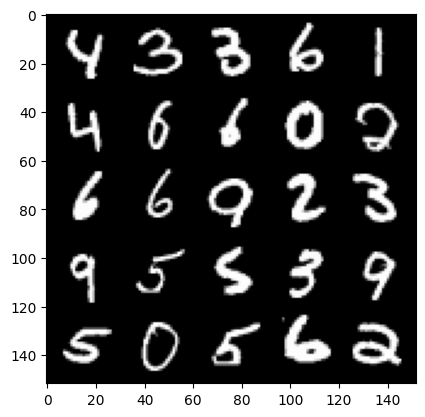

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 14/150 Step 6500 G_loss: 0.693372 D_loss: 0.693204


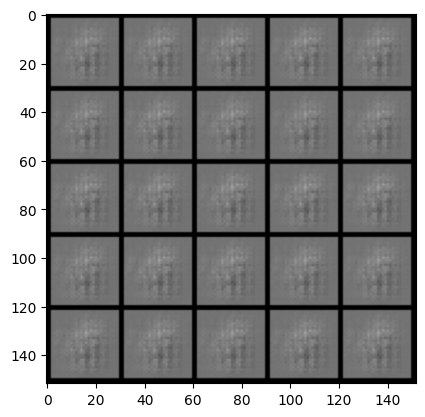

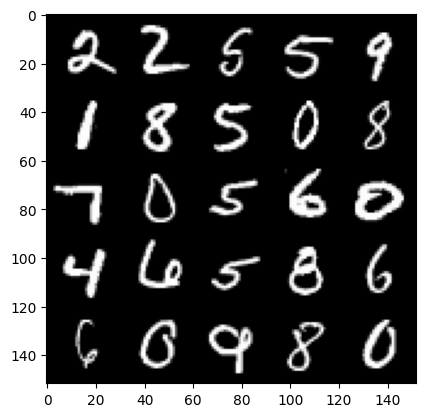

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 15/150 Step 7000 G_loss: 0.693625 D_loss: 0.693179


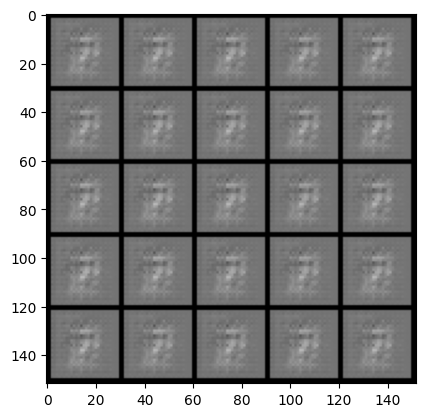

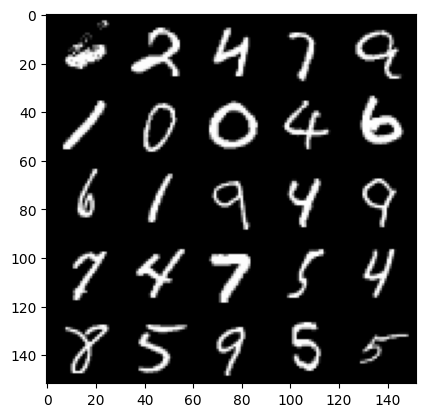

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 16/150 Step 7500 G_loss: 0.696495 D_loss: 0.690909


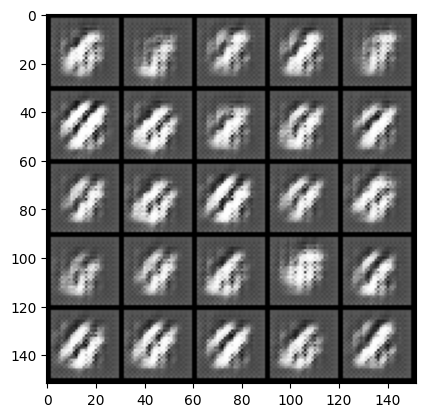

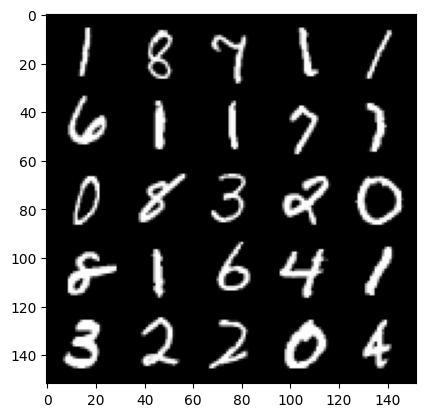

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 18/150 Step 8000 G_loss: 0.708621 D_loss: 0.682332


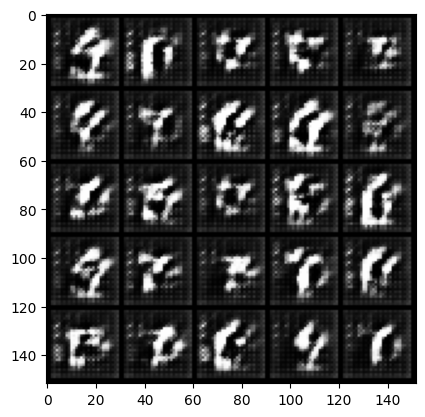

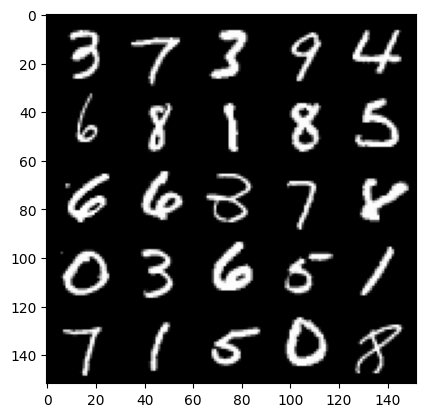

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 19/150 Step 8500 G_loss: 0.707412 D_loss: 0.689003


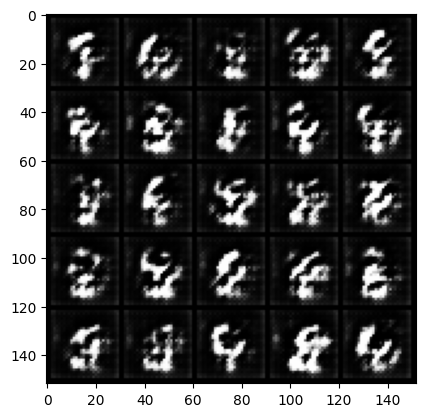

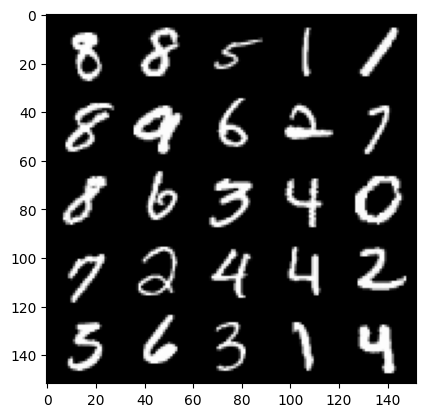

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 20/150 Step 9000 G_loss: 0.700483 D_loss: 0.690087


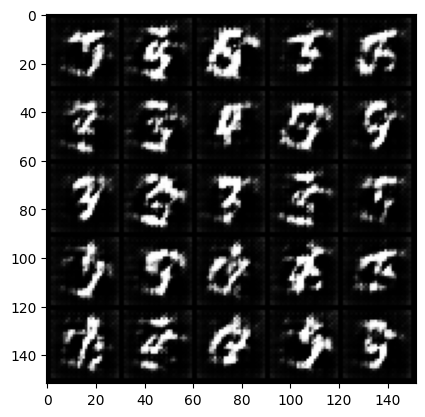

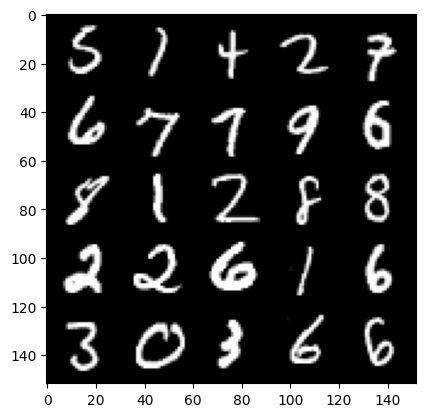

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 21/150 Step 9500 G_loss: 0.699352 D_loss: 0.691719


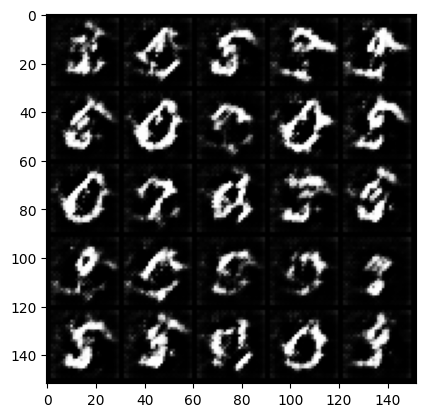

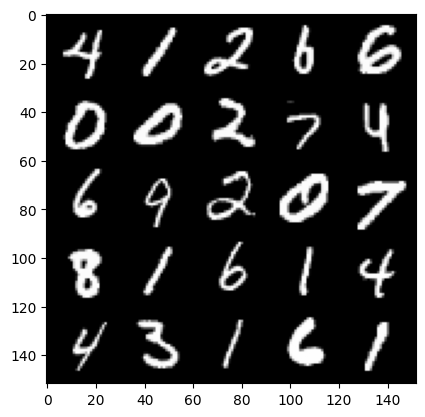

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 22/150 Step 10000 G_loss: 0.696430 D_loss: 0.692663


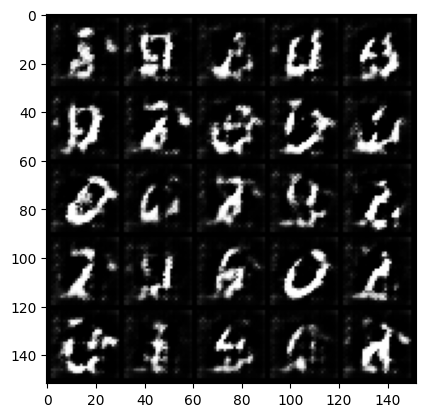

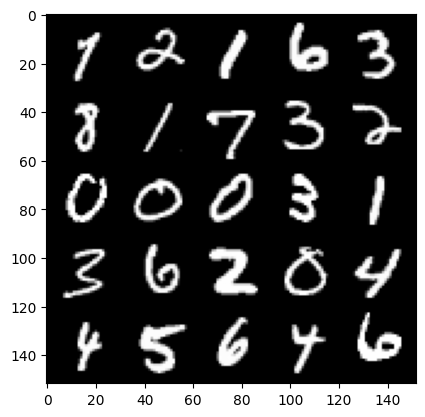

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 23/150 Step 10500 G_loss: 0.697626 D_loss: 0.692741


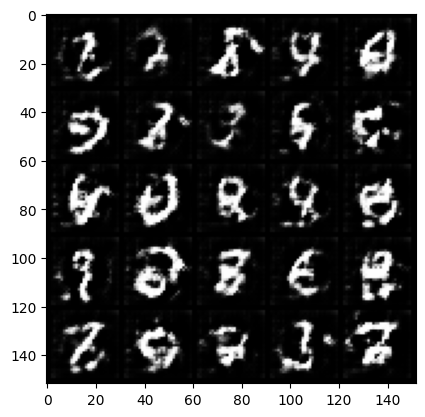

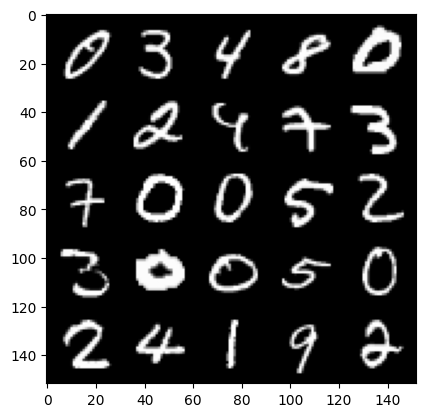

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 24/150 Step 11000 G_loss: 0.695368 D_loss: 0.692632


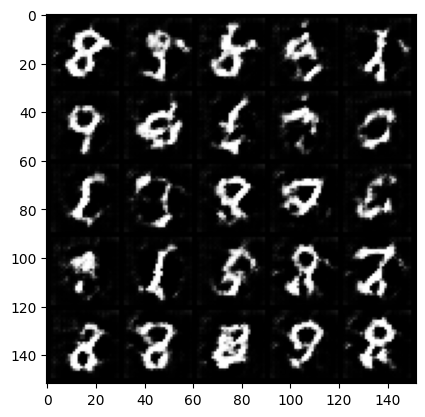

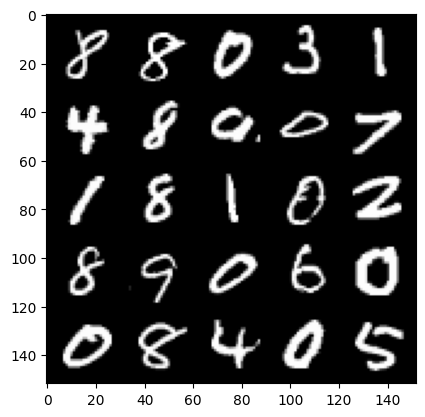

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 25/150 Step 11500 G_loss: 0.694968 D_loss: 0.692835


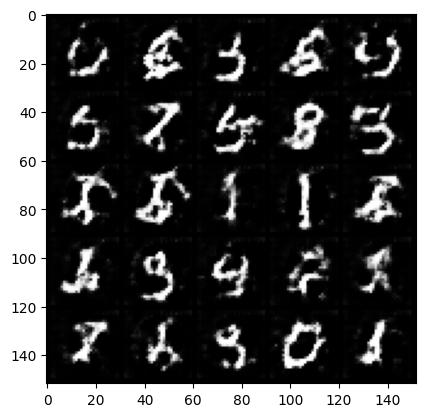

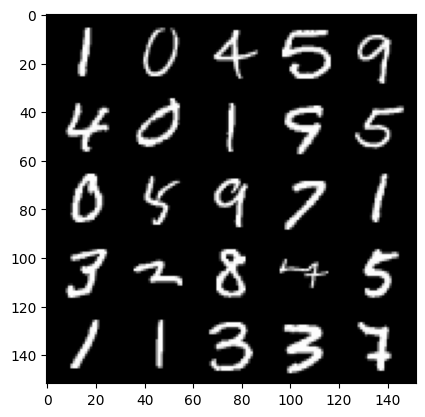

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 26/150 Step 12000 G_loss: 0.694713 D_loss: 0.692905


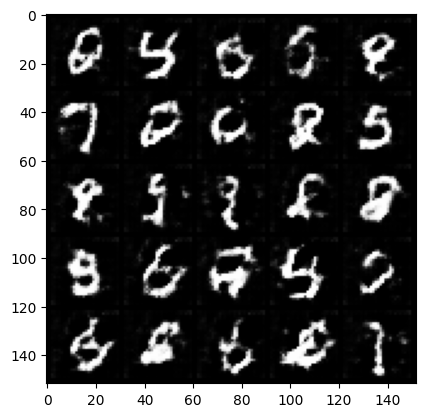

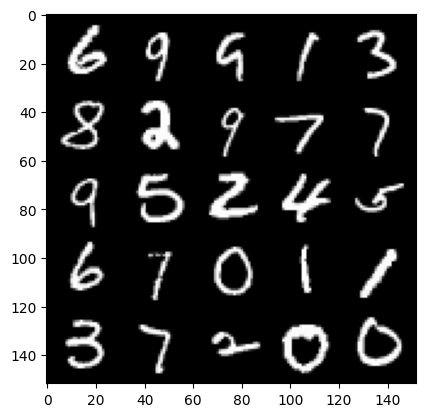

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 27/150 Step 12500 G_loss: 0.694308 D_loss: 0.692959


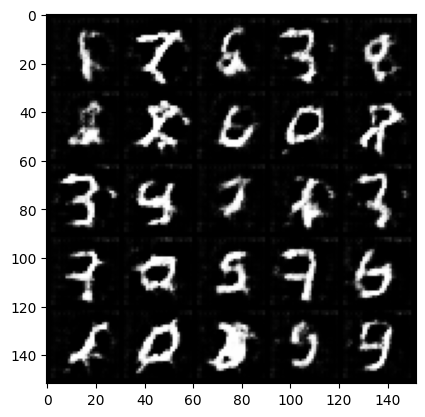

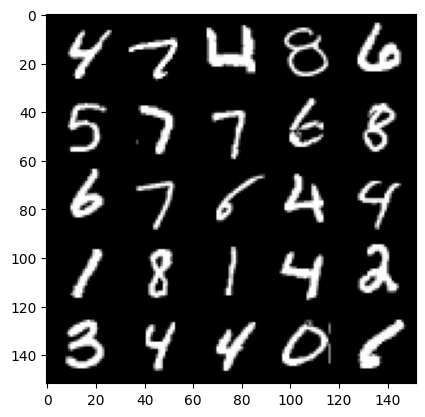

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 28/150 Step 13000 G_loss: 0.695171 D_loss: 0.692944


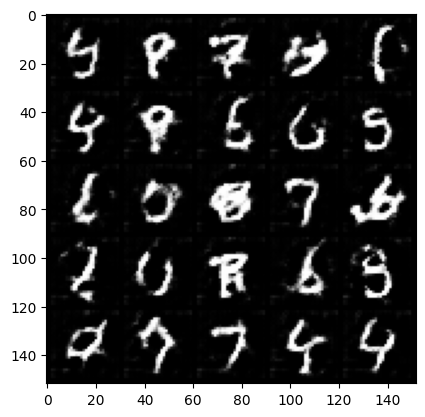

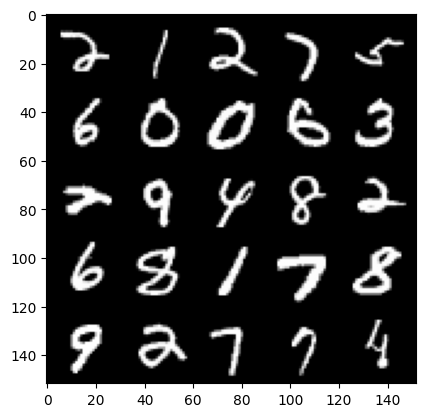

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 29/150 Step 13500 G_loss: 0.695101 D_loss: 0.692887


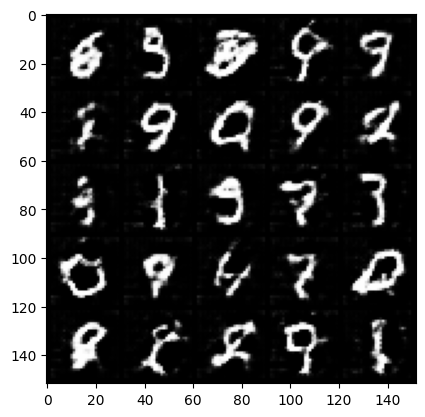

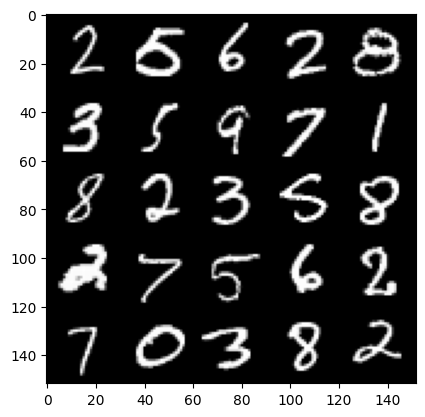

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 30/150 Step 14000 G_loss: 0.695050 D_loss: 0.692782


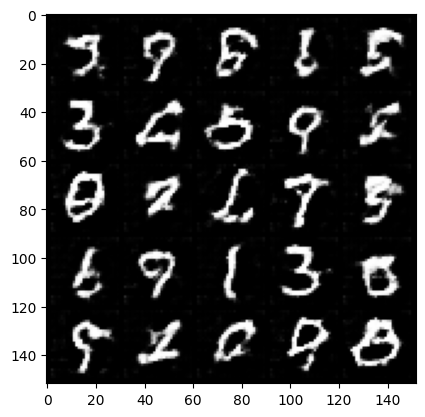

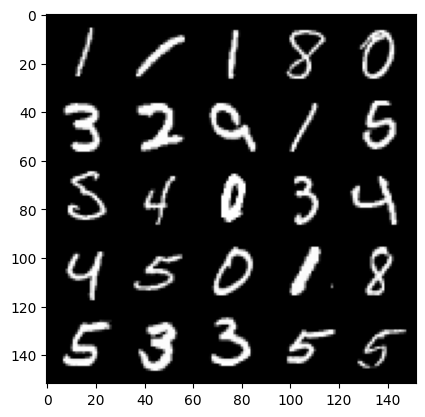

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 31/150 Step 14500 G_loss: 0.695197 D_loss: 0.692815


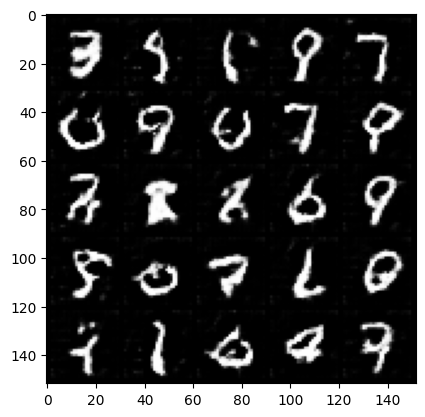

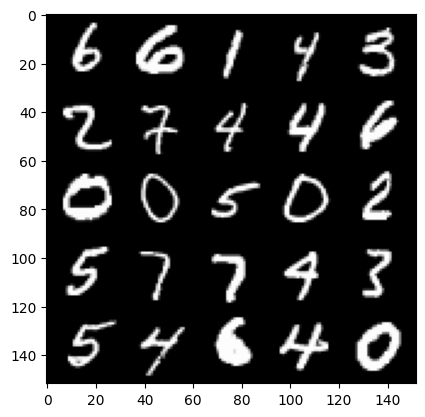

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 32/150 Step 15000 G_loss: 0.695121 D_loss: 0.692782


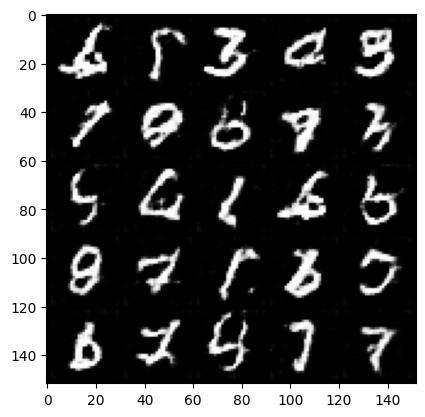

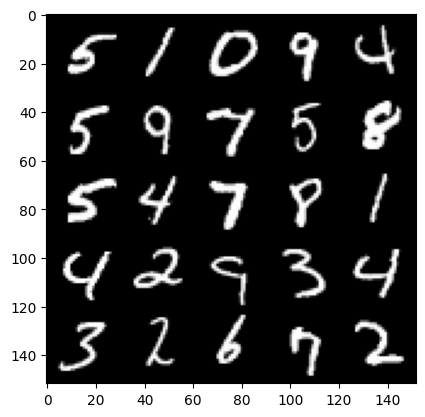

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 34/150 Step 15500 G_loss: 0.695389 D_loss: 0.692912


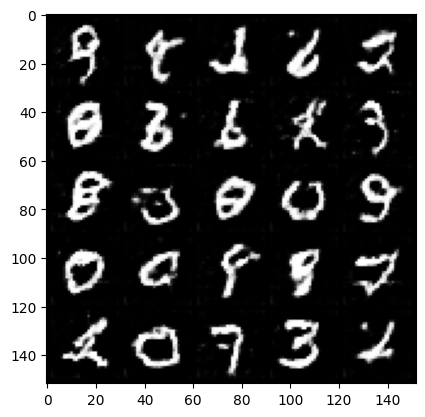

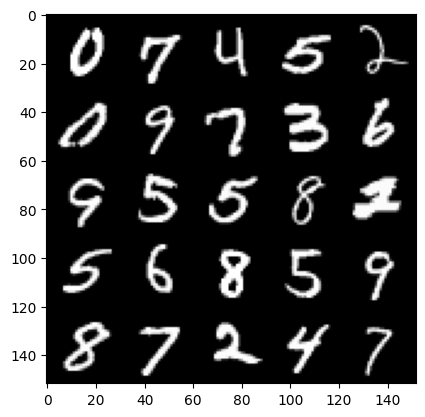

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 35/150 Step 16000 G_loss: 0.695159 D_loss: 0.693142


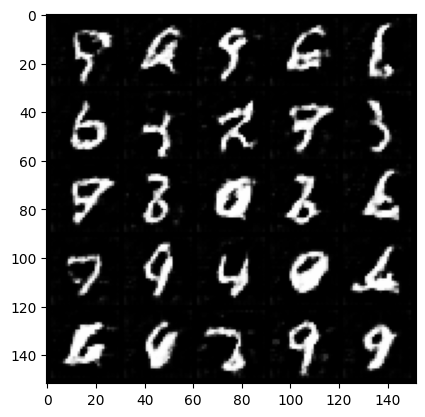

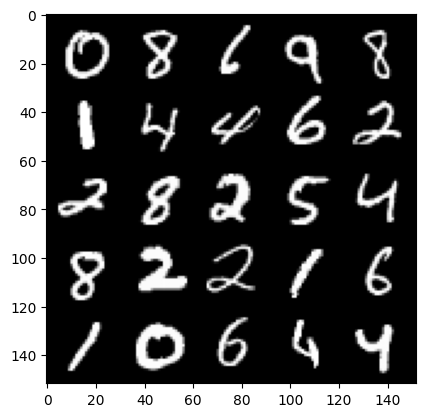

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 36/150 Step 16500 G_loss: 0.694888 D_loss: 0.693212


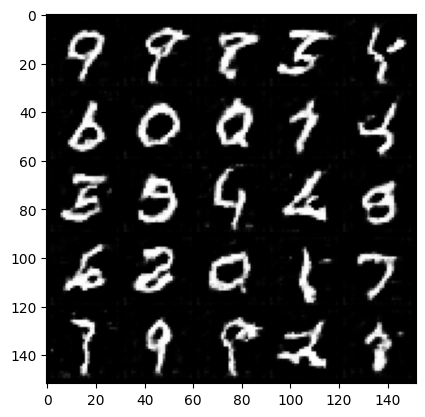

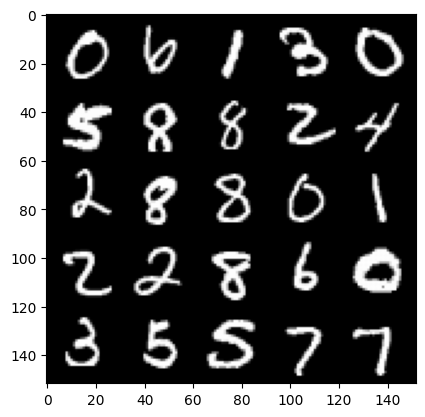

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 37/150 Step 17000 G_loss: 0.694317 D_loss: 0.693226


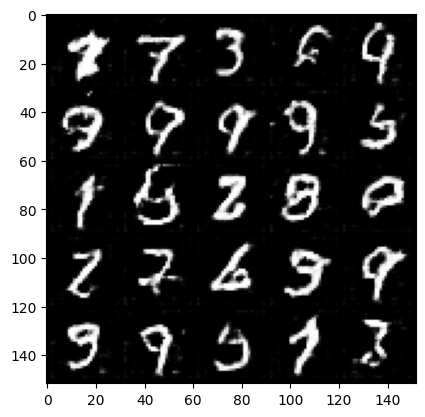

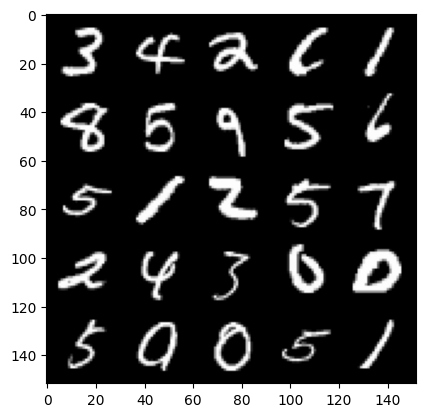

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 38/150 Step 17500 G_loss: 0.694813 D_loss: 0.693212


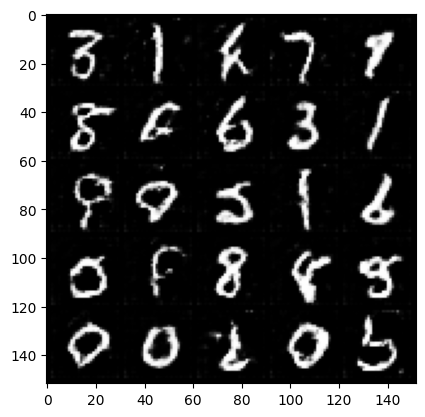

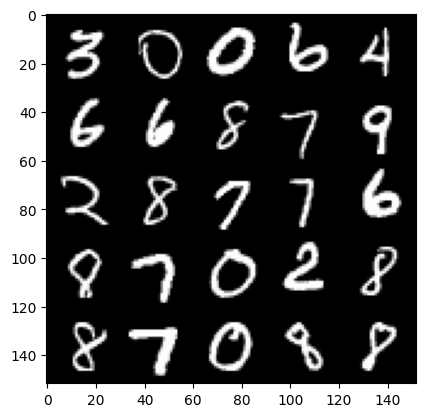

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 39/150 Step 18000 G_loss: 0.694534 D_loss: 0.693192


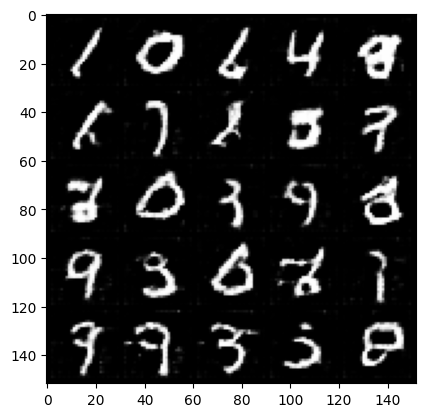

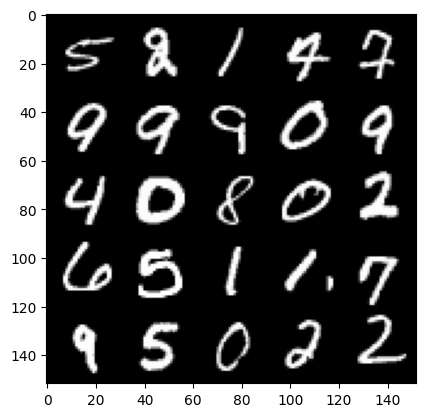

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 40/150 Step 18500 G_loss: 0.694727 D_loss: 0.693275


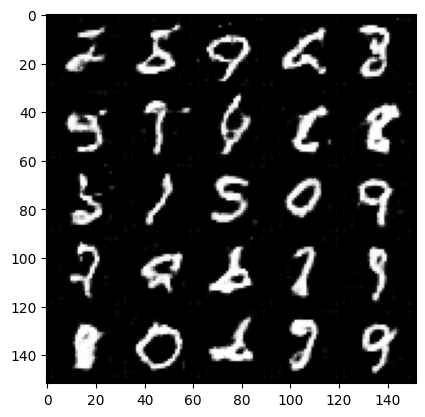

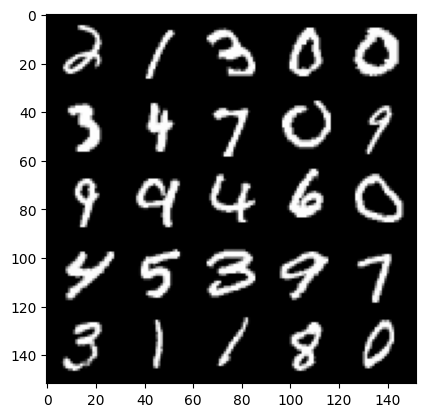

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 41/150 Step 19000 G_loss: 0.694735 D_loss: 0.693297


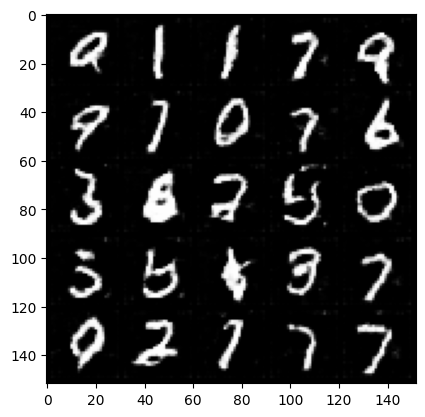

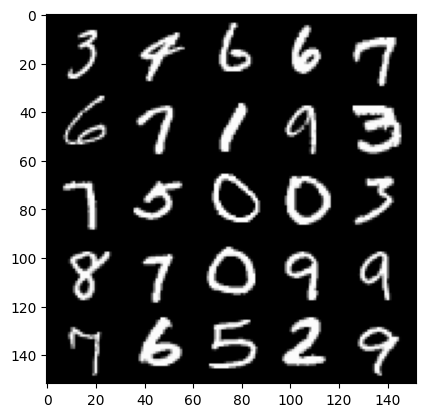

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 42/150 Step 19500 G_loss: 0.694327 D_loss: 0.693318


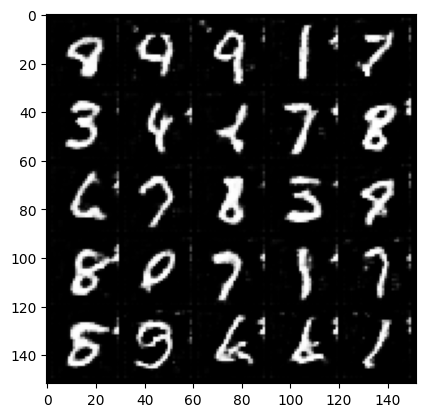

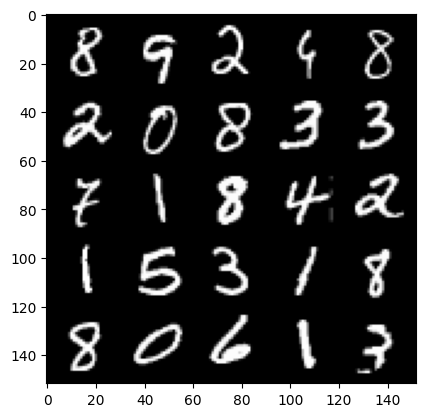

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 43/150 Step 20000 G_loss: 0.693765 D_loss: 0.693389


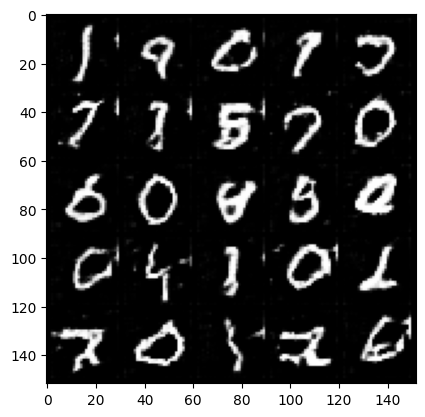

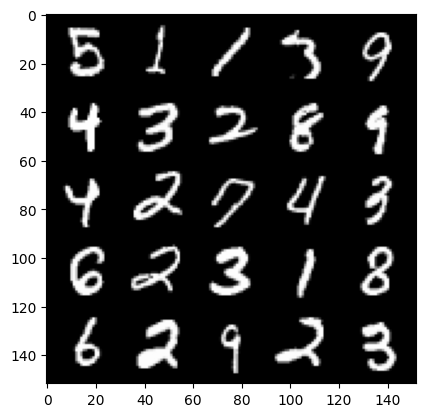

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 44/150 Step 20500 G_loss: 0.694077 D_loss: 0.693435


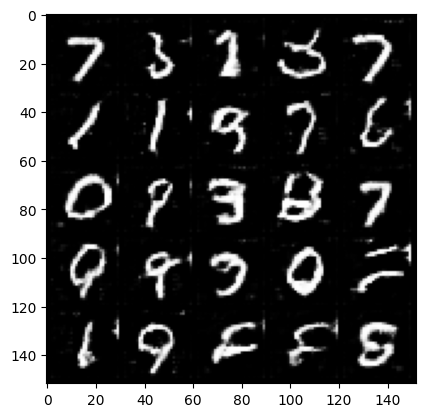

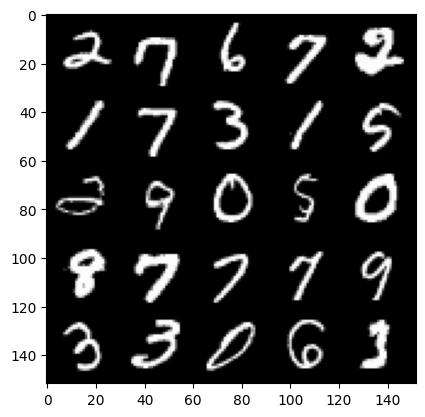

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 45/150 Step 21000 G_loss: 0.693935 D_loss: 0.693471


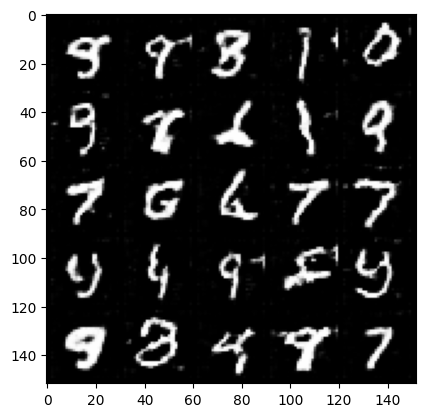

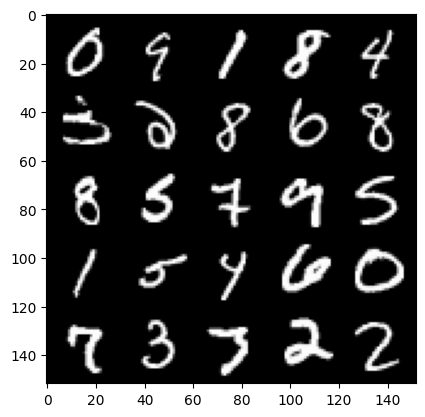

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 46/150 Step 21500 G_loss: 0.693784 D_loss: 0.693509


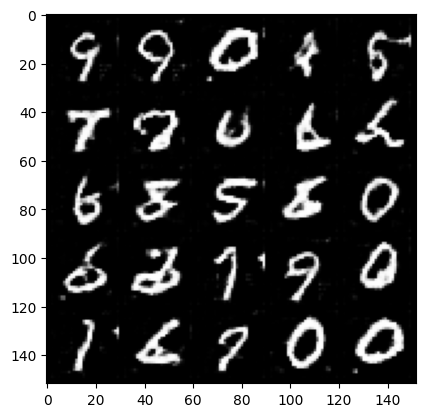

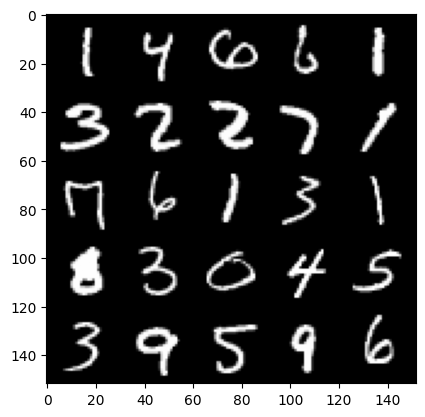

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 47/150 Step 22000 G_loss: 0.694281 D_loss: 0.693516


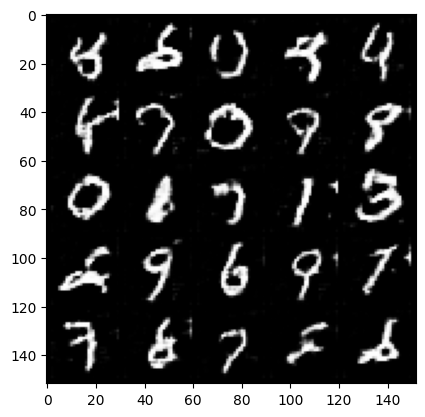

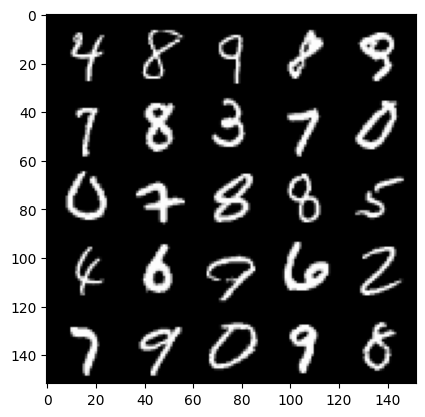

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 48/150 Step 22500 G_loss: 0.694040 D_loss: 0.693542


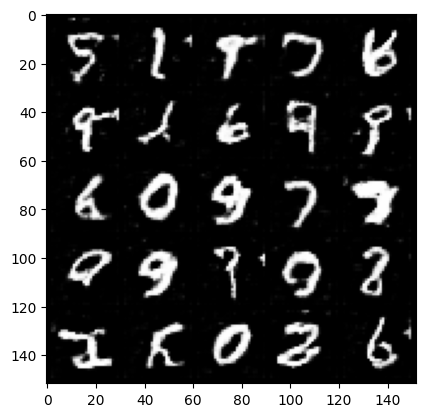

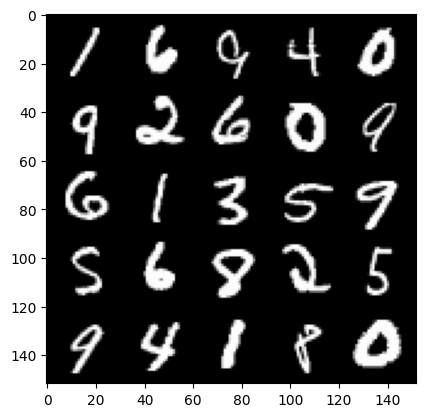

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 50/150 Step 23000 G_loss: 0.693347 D_loss: 0.693451


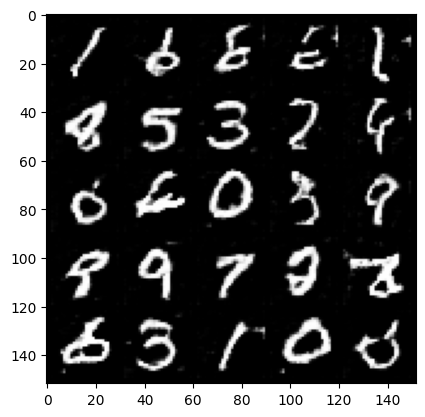

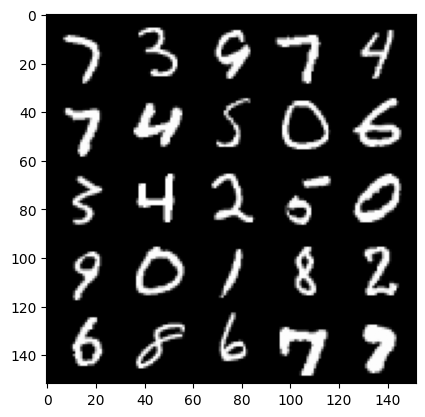

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 51/150 Step 23500 G_loss: 0.693446 D_loss: 0.693417


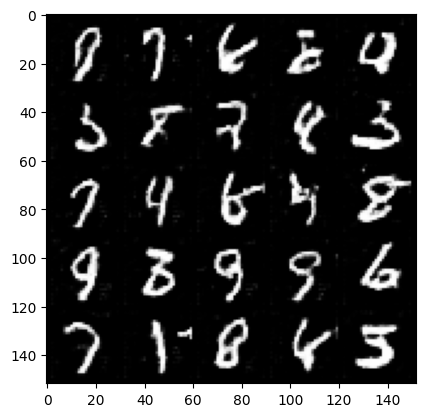

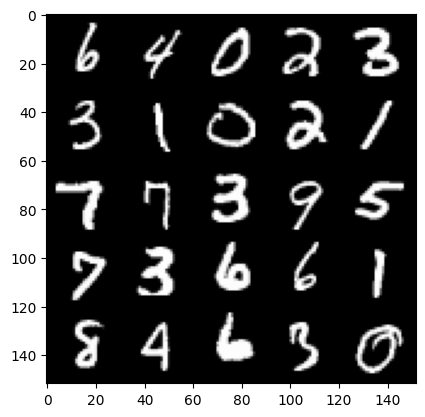

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 52/150 Step 24000 G_loss: 0.693663 D_loss: 0.693428


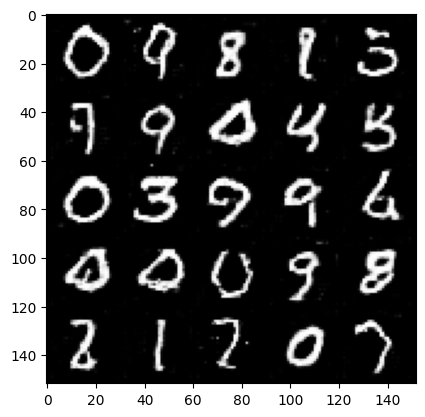

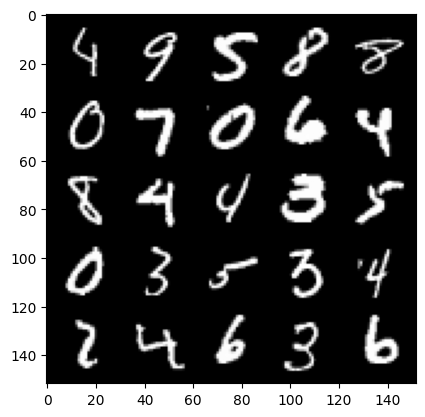

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 53/150 Step 24500 G_loss: 0.693792 D_loss: 0.693435


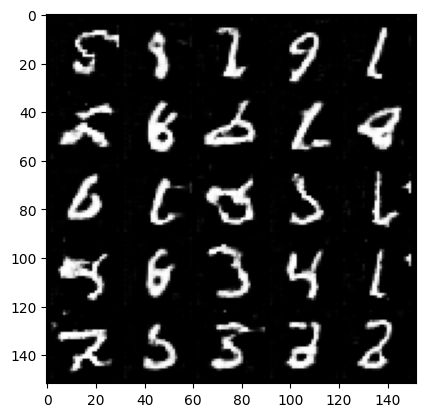

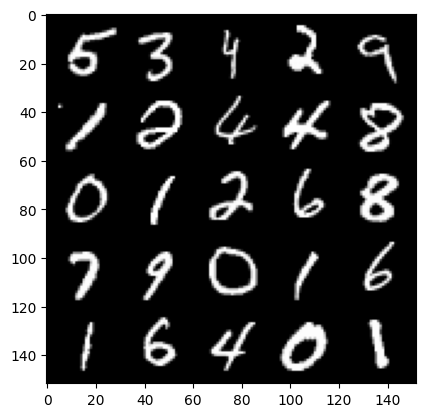

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 54/150 Step 25000 G_loss: 0.693291 D_loss: 0.693353


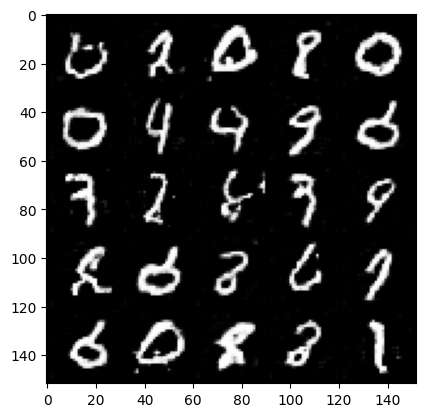

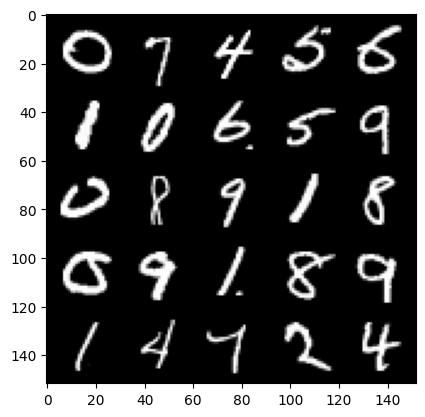

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 55/150 Step 25500 G_loss: 0.693728 D_loss: 0.693414


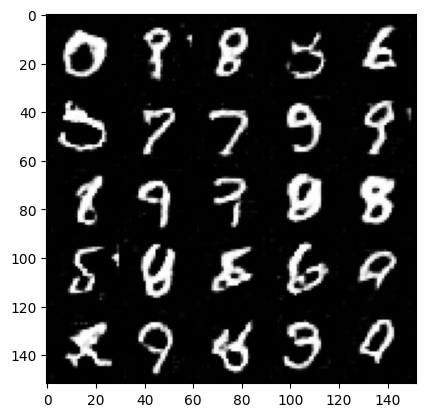

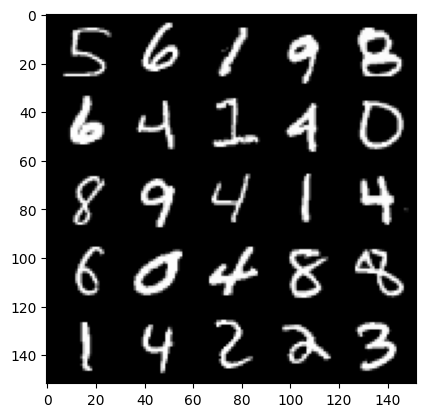

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 56/150 Step 26000 G_loss: 0.693345 D_loss: 0.693370


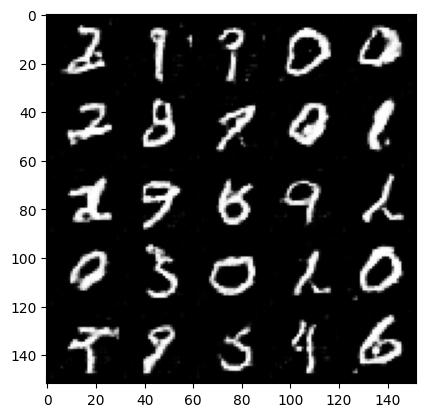

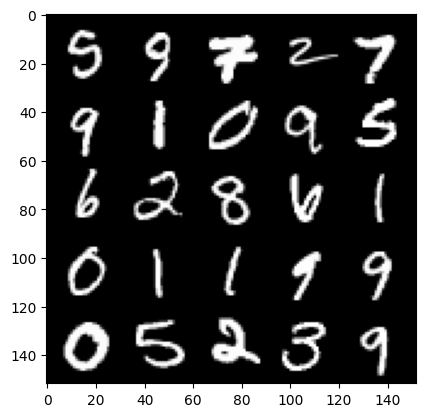

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 57/150 Step 26500 G_loss: 0.693605 D_loss: 0.693371


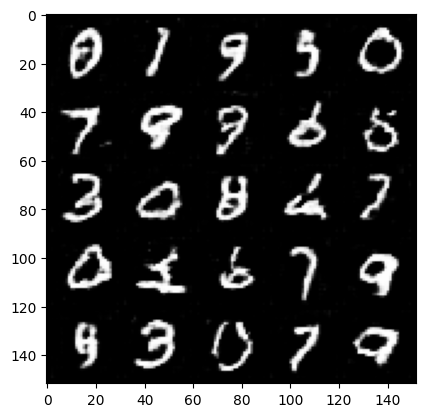

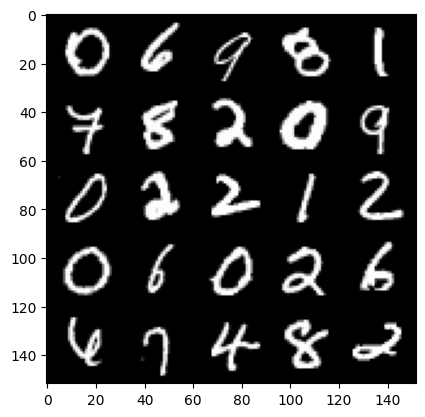

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 58/150 Step 27000 G_loss: 0.693321 D_loss: 0.693326


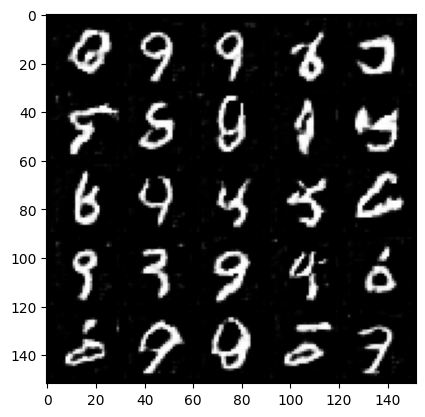

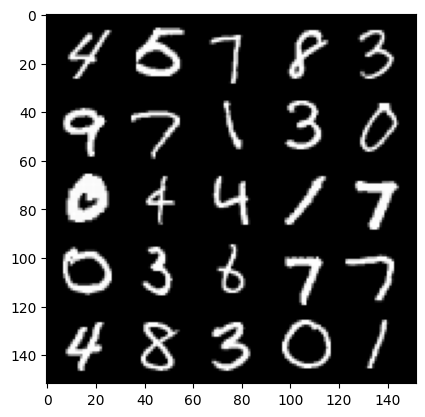

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 59/150 Step 27500 G_loss: 0.693434 D_loss: 0.693318


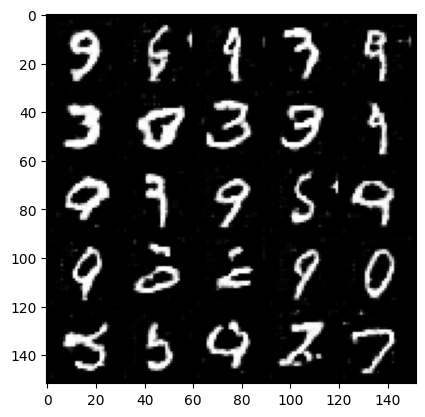

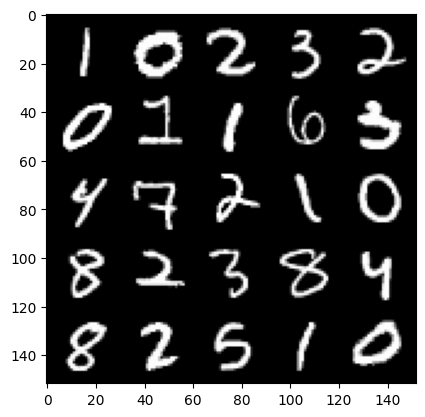

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 60/150 Step 28000 G_loss: 0.693263 D_loss: 0.693324


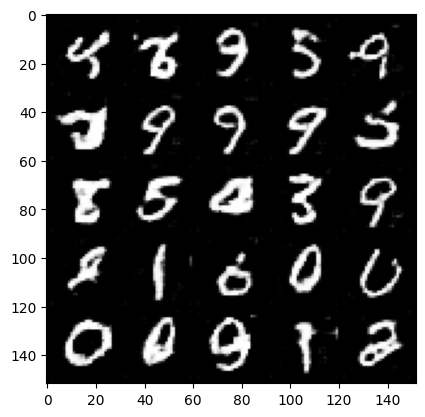

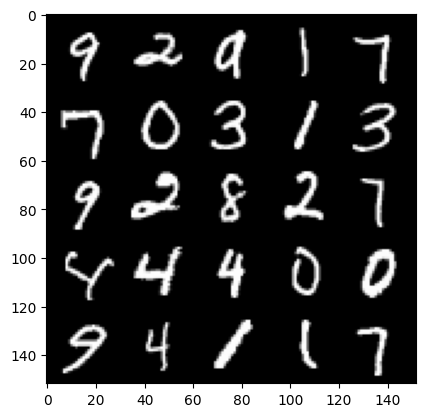

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 61/150 Step 28500 G_loss: 0.693473 D_loss: 0.693308


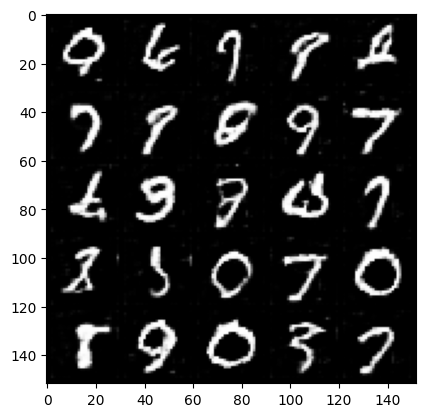

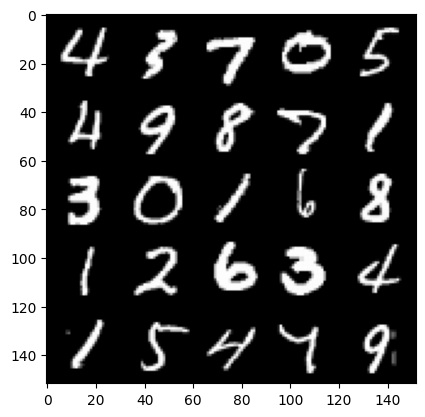

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 62/150 Step 29000 G_loss: 0.693383 D_loss: 0.693285


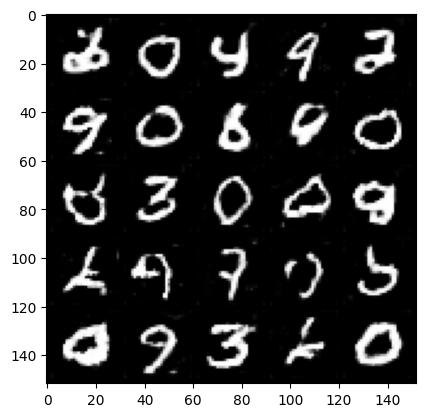

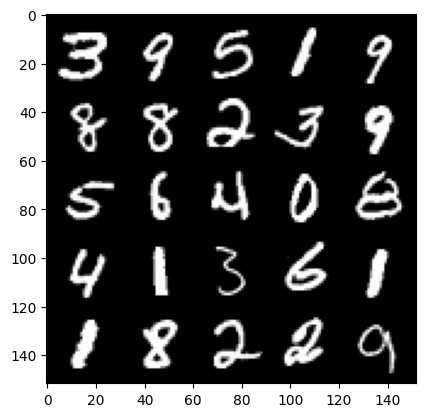

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 63/150 Step 29500 G_loss: 0.693252 D_loss: 0.693281


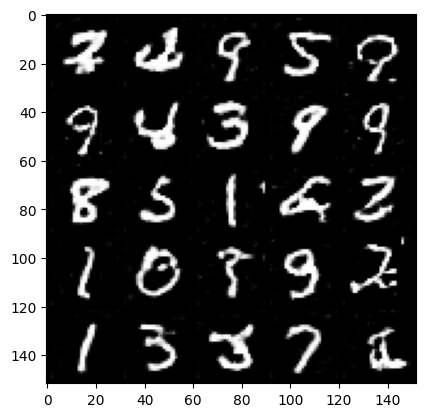

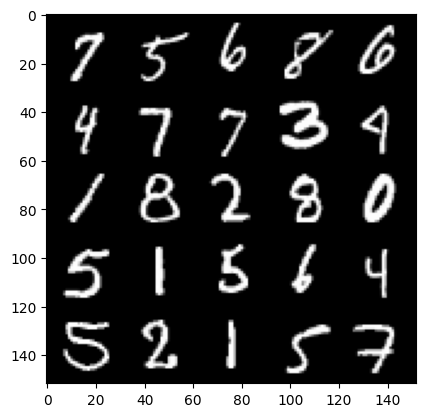

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 64/150 Step 30000 G_loss: 0.693305 D_loss: 0.693261


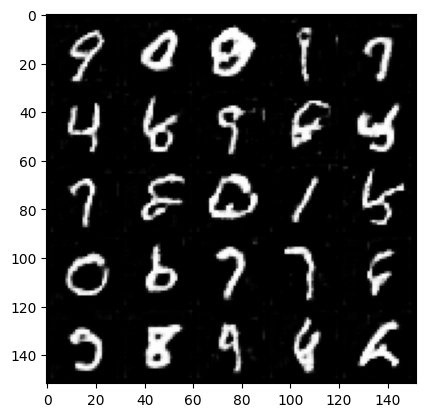

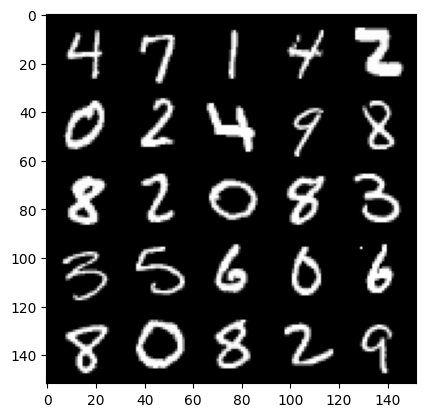

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 66/150 Step 30500 G_loss: 0.693247 D_loss: 0.693257


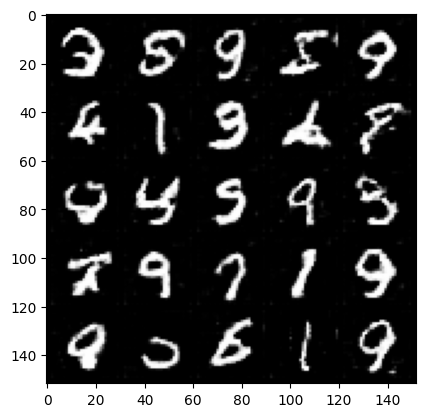

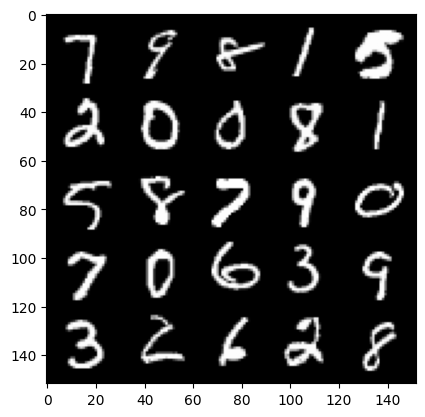

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 67/150 Step 31000 G_loss: 0.693533 D_loss: 0.693280


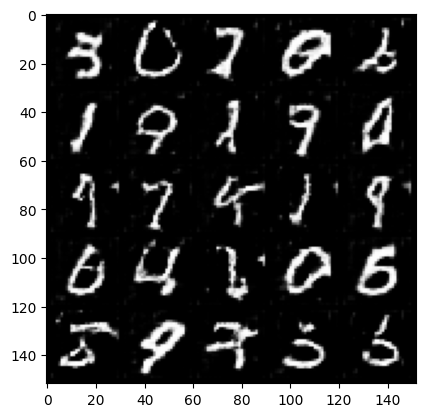

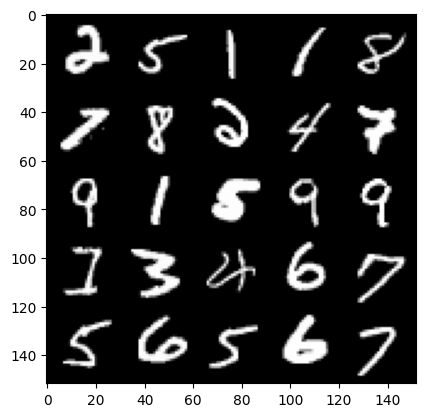

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 68/150 Step 31500 G_loss: 0.693137 D_loss: 0.693254


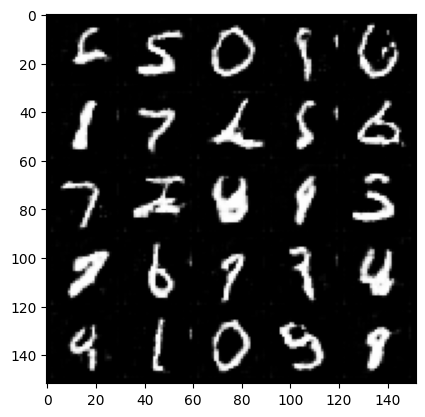

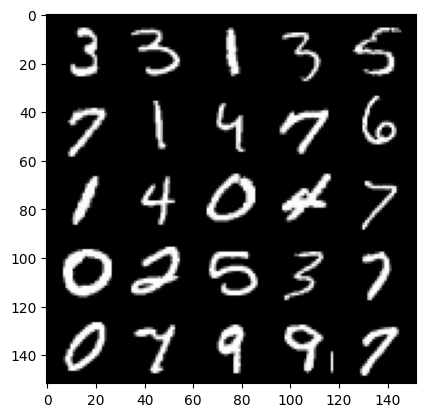

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 69/150 Step 32000 G_loss: 0.693249 D_loss: 0.693227


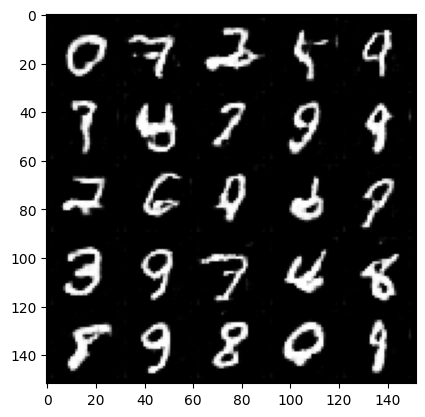

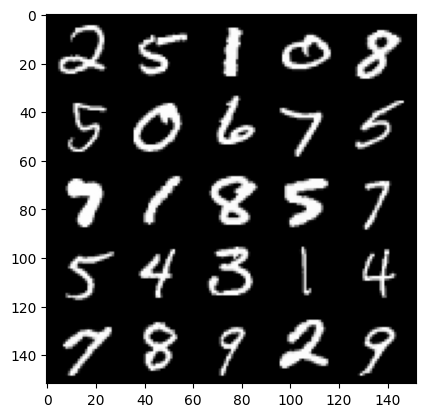

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 70/150 Step 32500 G_loss: 0.693259 D_loss: 0.693231


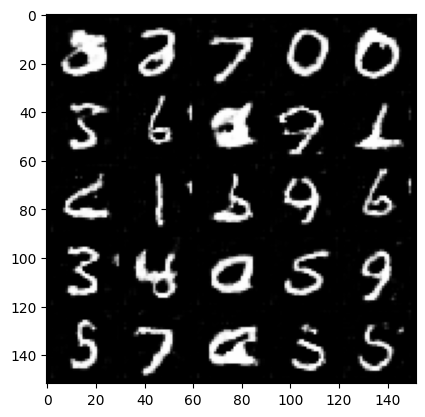

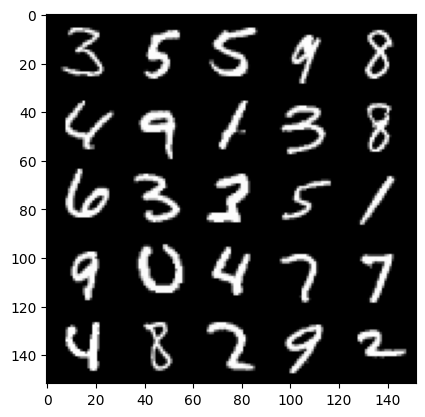

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 71/150 Step 33000 G_loss: 0.693310 D_loss: 0.693241


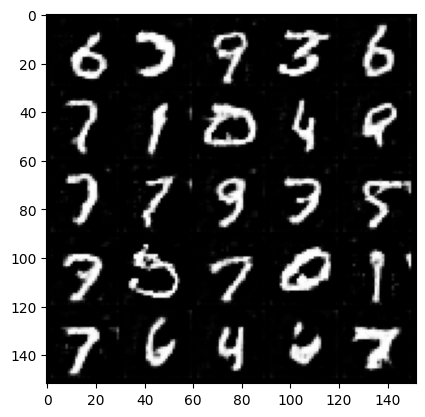

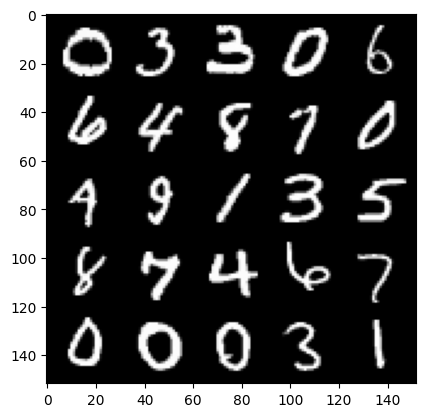

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 72/150 Step 33500 G_loss: 0.693199 D_loss: 0.693219


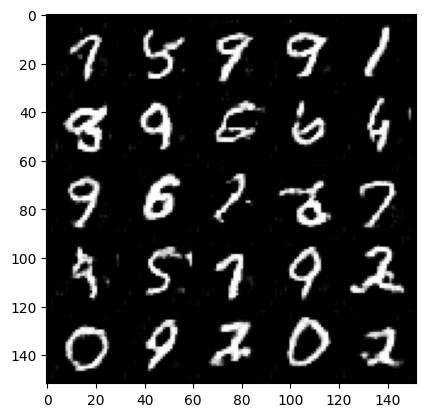

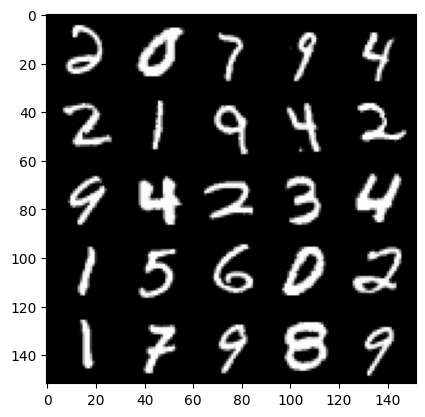

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 73/150 Step 34000 G_loss: 0.693365 D_loss: 0.693219


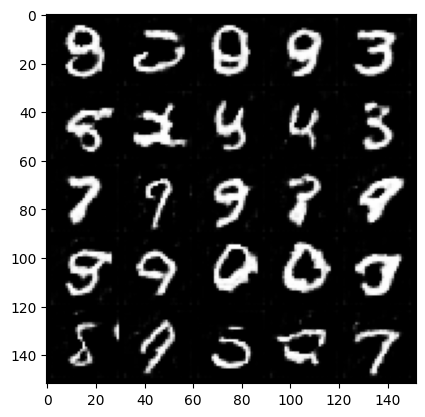

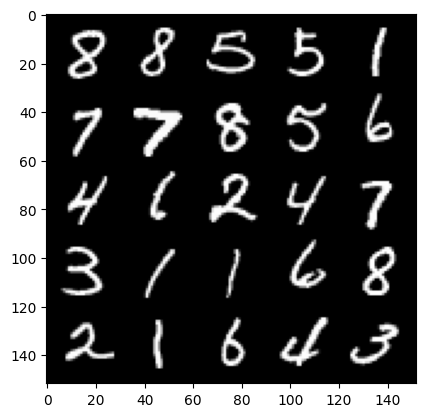

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 74/150 Step 34500 G_loss: 0.693158 D_loss: 0.693230


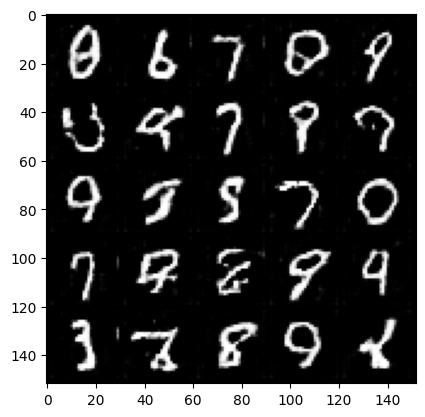

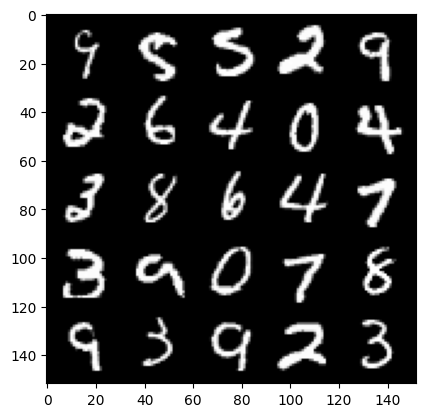

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 75/150 Step 35000 G_loss: 0.693153 D_loss: 0.693211


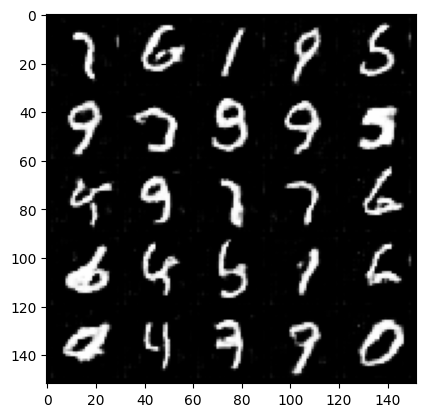

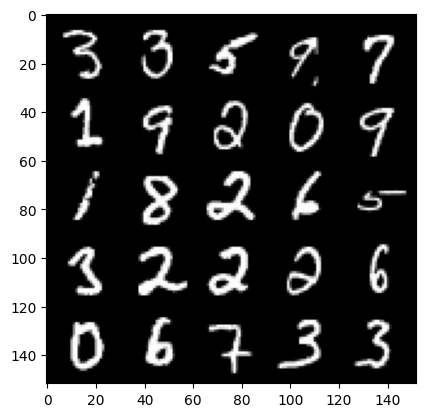

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 76/150 Step 35500 G_loss: 0.693382 D_loss: 0.693194


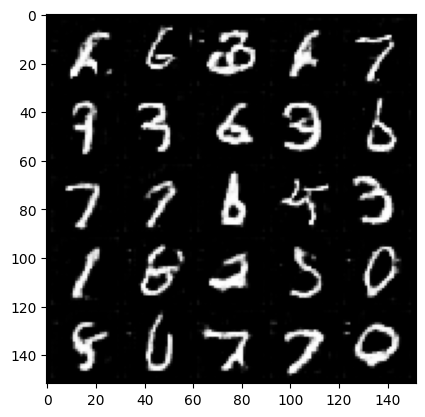

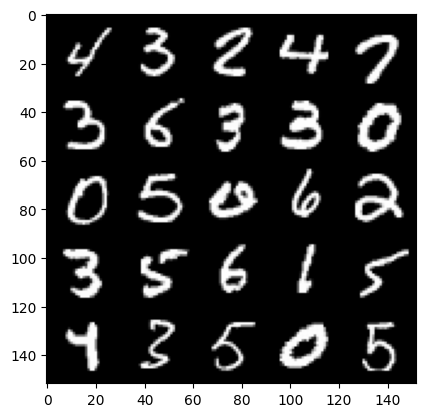

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 77/150 Step 36000 G_loss: 0.693109 D_loss: 0.693203


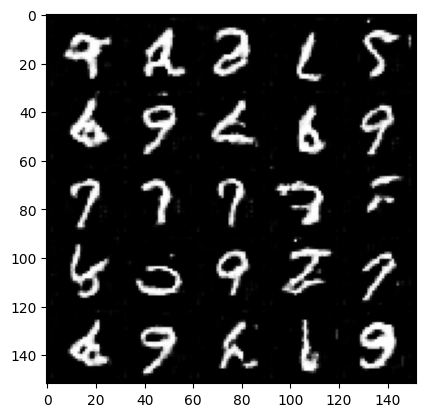

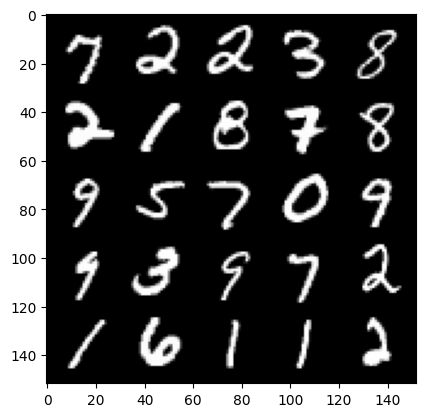

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 78/150 Step 36500 G_loss: 0.693266 D_loss: 0.693188


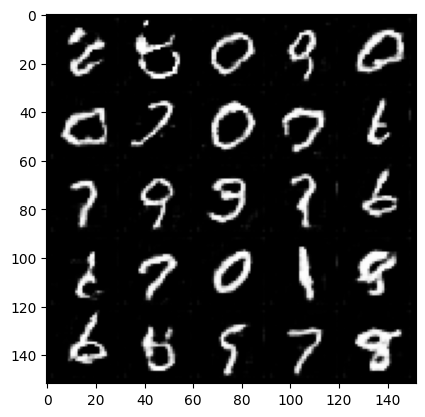

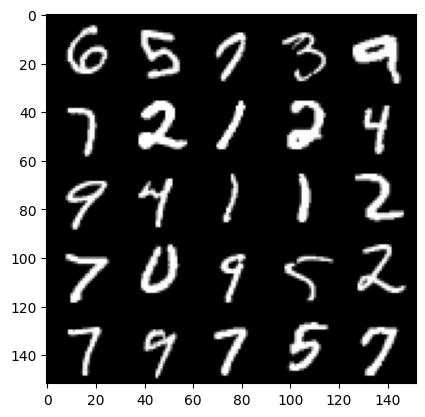

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 79/150 Step 37000 G_loss: 0.693204 D_loss: 0.693200


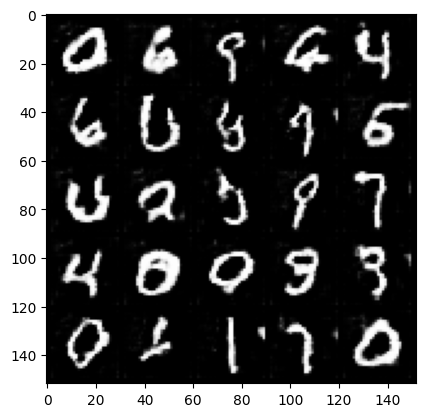

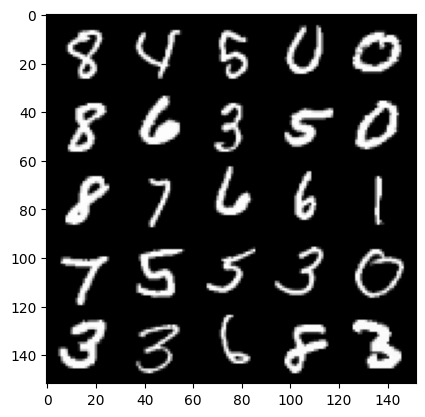

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 80/150 Step 37500 G_loss: 0.693382 D_loss: 0.693192


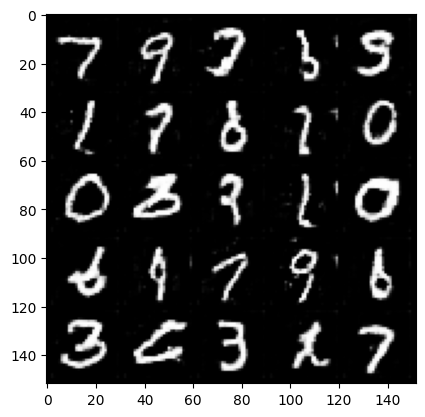

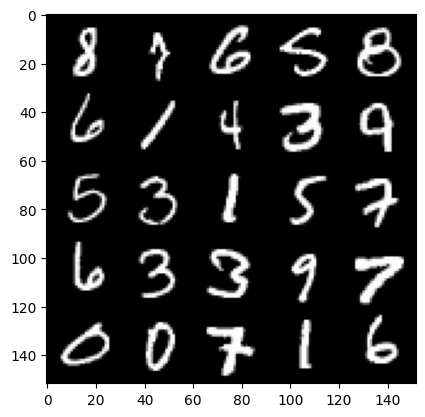

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 82/150 Step 38000 G_loss: 0.693139 D_loss: 0.693199


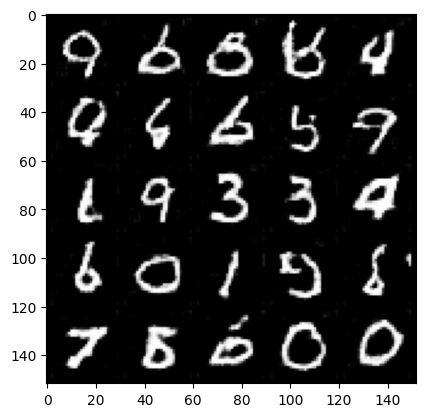

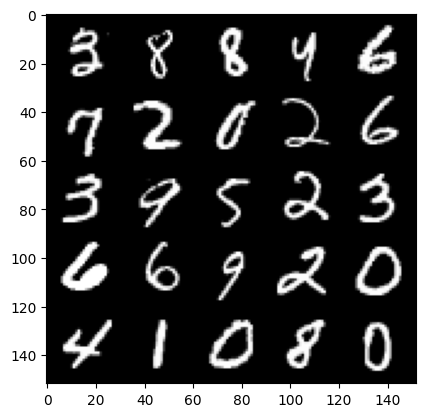

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 83/150 Step 38500 G_loss: 0.693224 D_loss: 0.693190


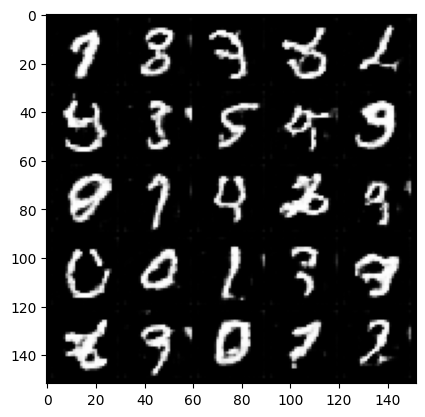

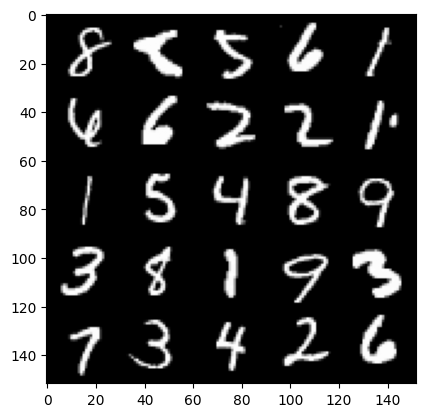

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 84/150 Step 39000 G_loss: 0.693191 D_loss: 0.693179


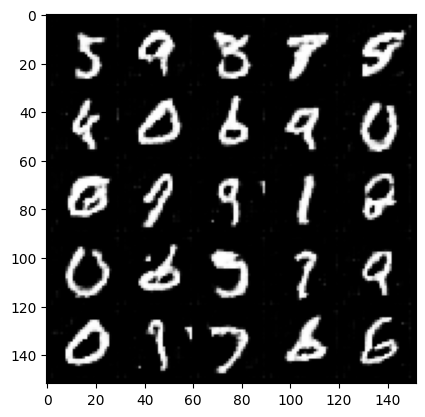

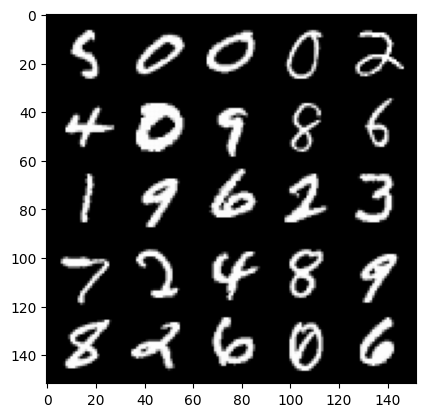

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 85/150 Step 39500 G_loss: 0.693293 D_loss: 0.693175


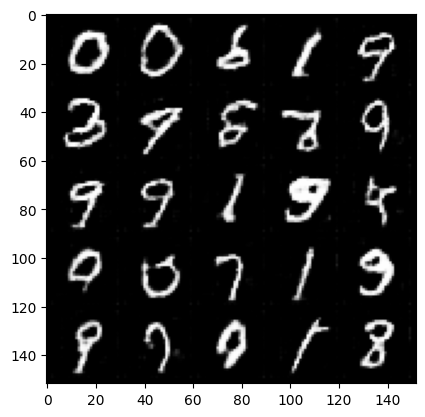

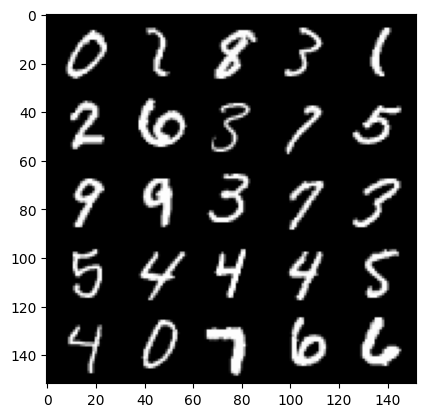

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 86/150 Step 40000 G_loss: 0.693169 D_loss: 0.693175


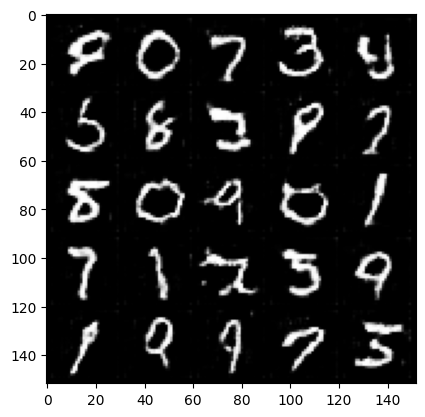

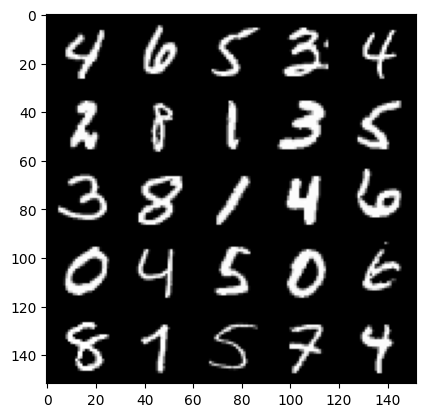

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 87/150 Step 40500 G_loss: 0.693140 D_loss: 0.693184


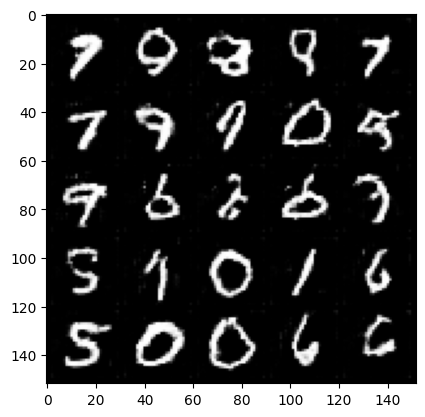

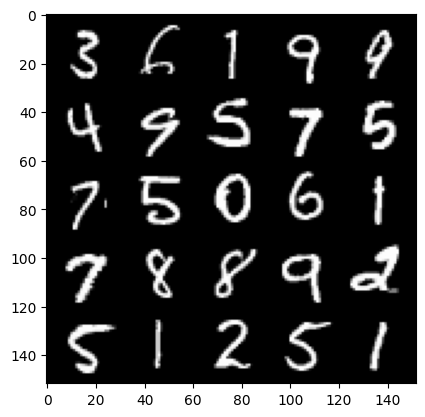

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 88/150 Step 41000 G_loss: 0.693282 D_loss: 0.693179


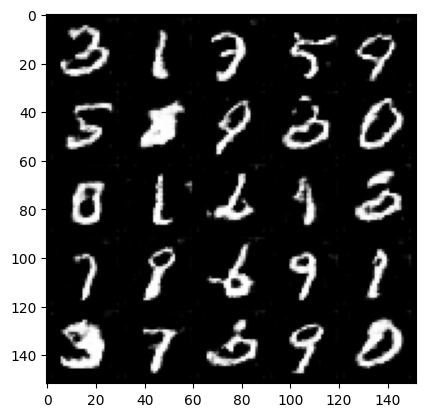

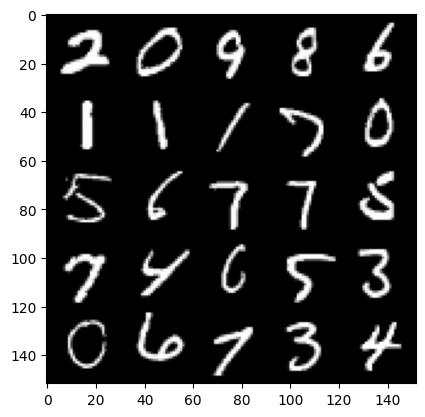

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 89/150 Step 41500 G_loss: 0.693124 D_loss: 0.693188


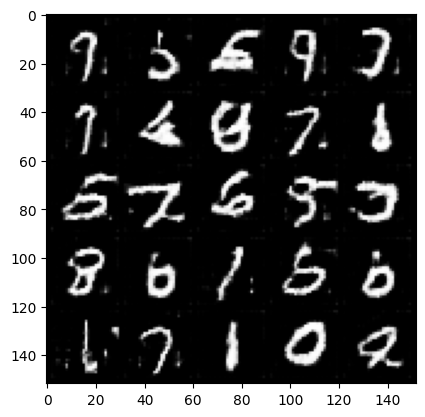

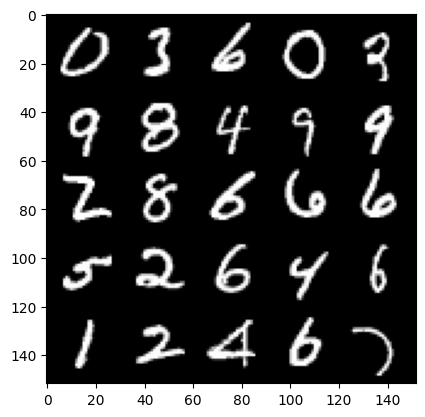

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 90/150 Step 42000 G_loss: 0.693174 D_loss: 0.693177


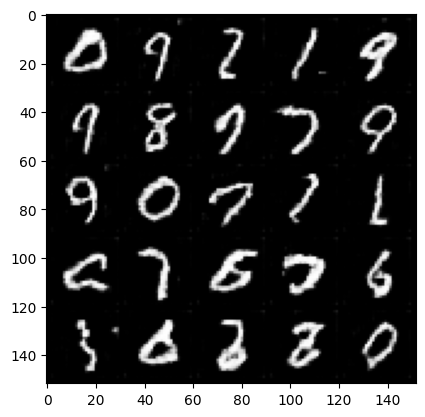

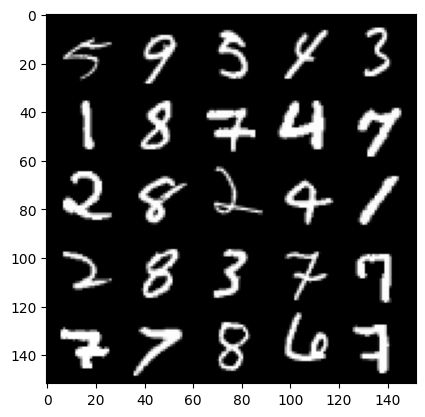

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 91/150 Step 42500 G_loss: 0.693128 D_loss: 0.693171


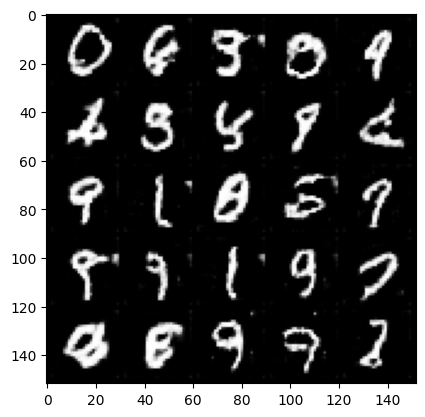

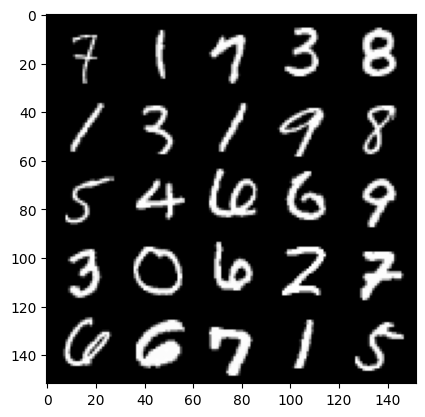

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 92/150 Step 43000 G_loss: 0.693204 D_loss: 0.693176


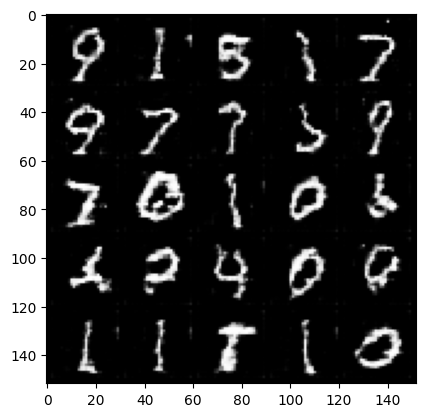

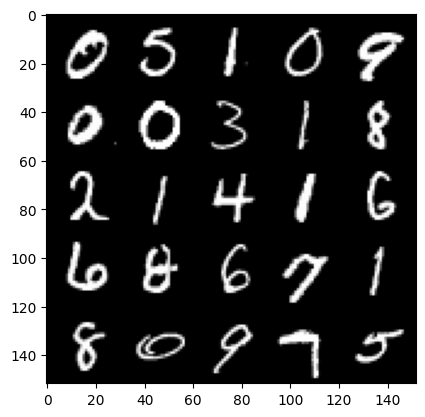

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 93/150 Step 43500 G_loss: 0.693193 D_loss: 0.693173


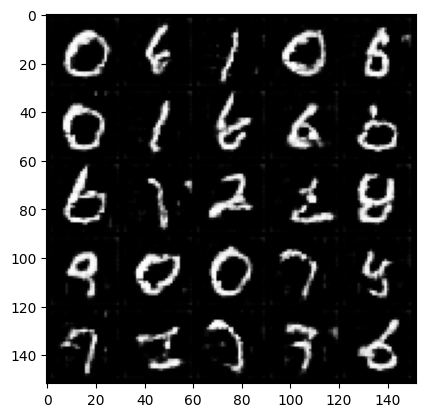

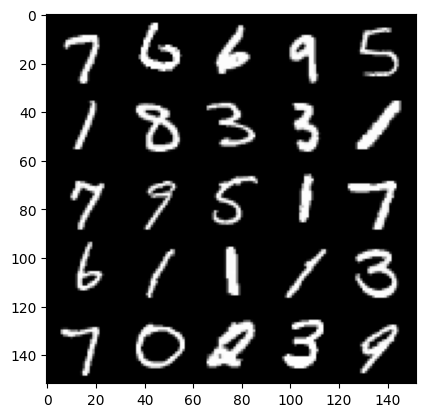

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 94/150 Step 44000 G_loss: 0.693200 D_loss: 0.693169


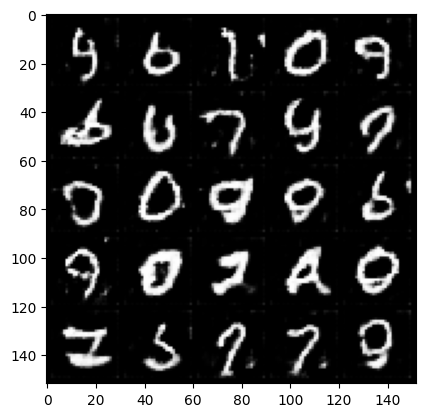

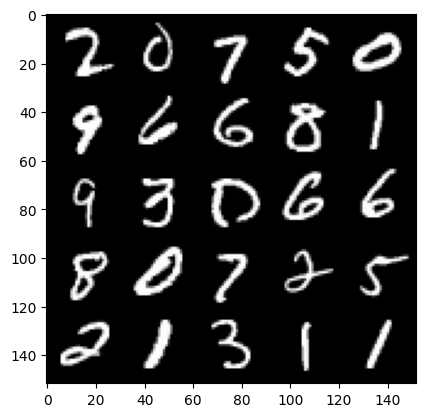

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 95/150 Step 44500 G_loss: 0.693164 D_loss: 0.693162


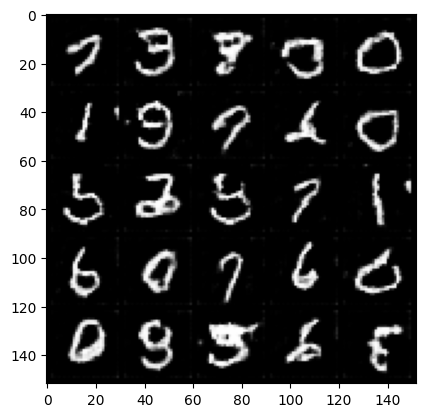

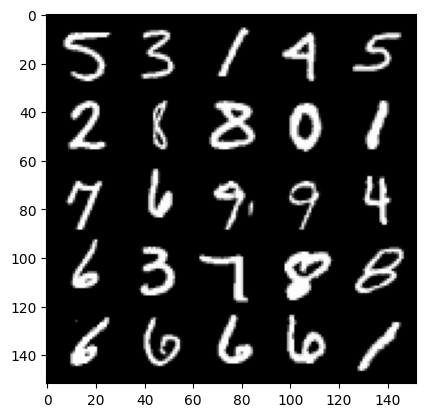

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 96/150 Step 45000 G_loss: 0.693133 D_loss: 0.693164


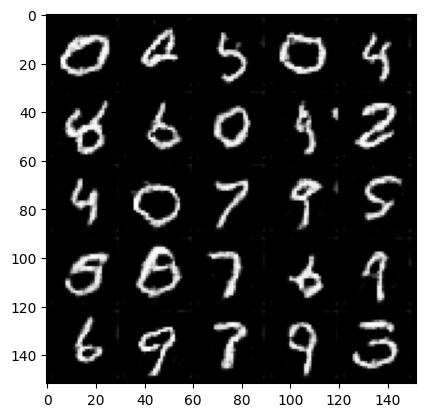

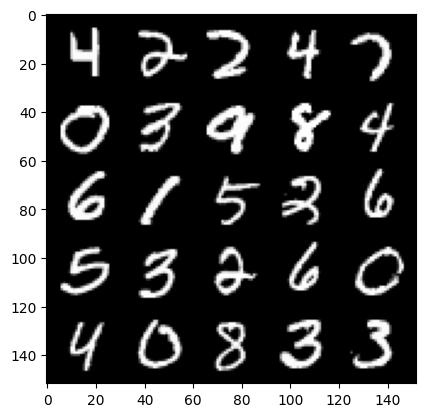

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 98/150 Step 45500 G_loss: 0.693170 D_loss: 0.693160


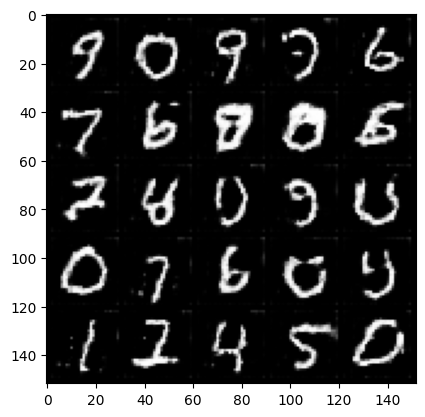

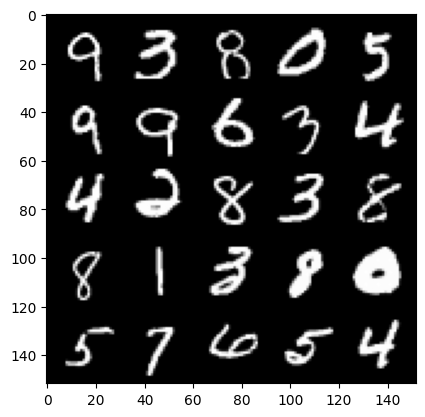

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 99/150 Step 46000 G_loss: 0.693160 D_loss: 0.693162


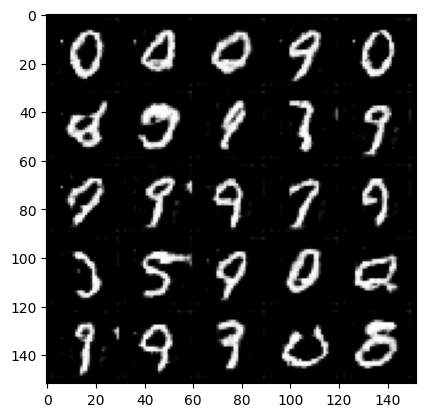

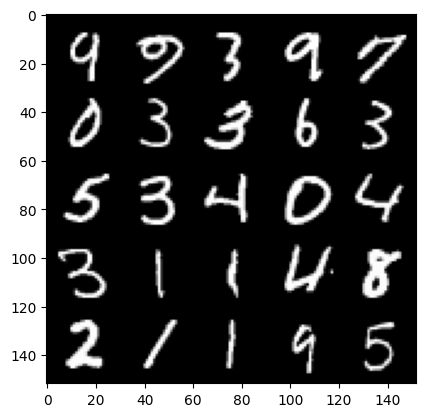

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 100/150 Step 46500 G_loss: 0.693164 D_loss: 0.693158


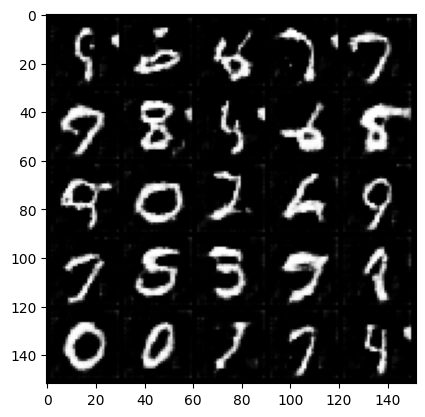

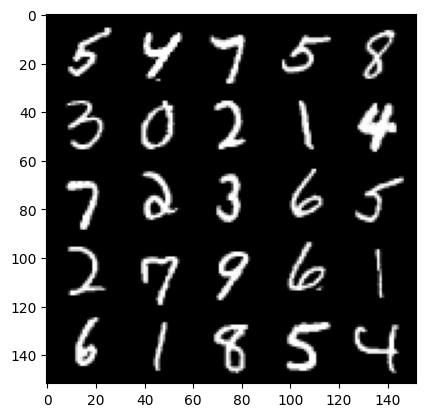

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 101/150 Step 47000 G_loss: 0.693153 D_loss: 0.693153


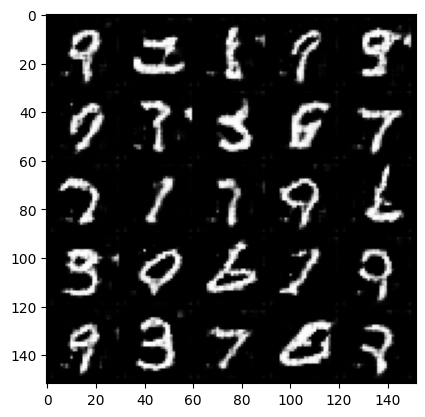

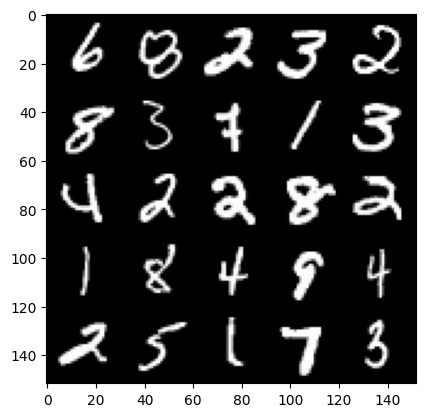

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 102/150 Step 47500 G_loss: 0.693160 D_loss: 0.693158


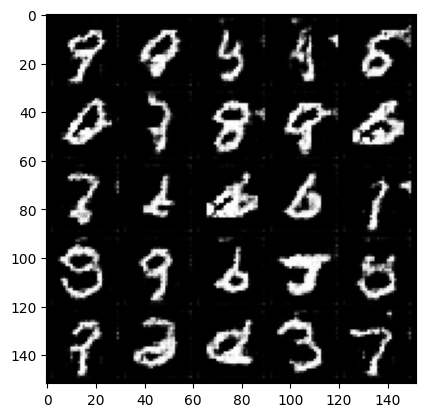

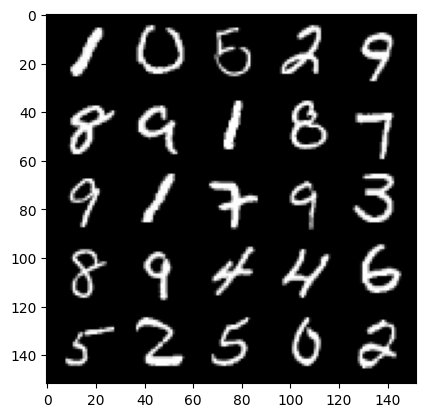

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 103/150 Step 48000 G_loss: 0.693269 D_loss: 0.693164


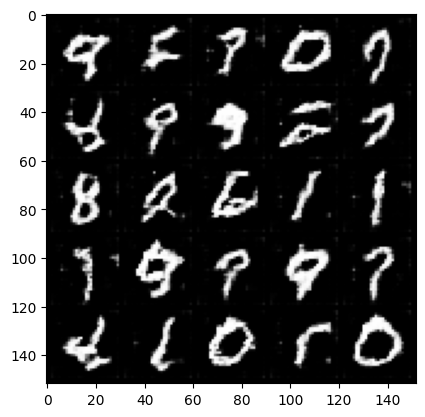

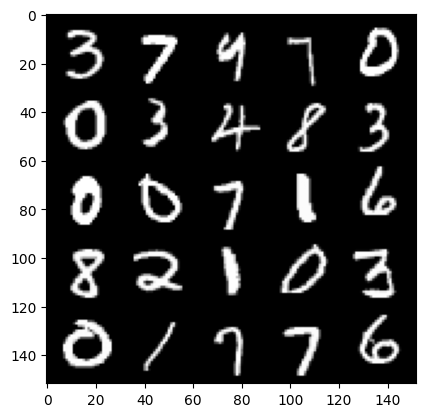

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 104/150 Step 48500 G_loss: 0.693171 D_loss: 0.693168


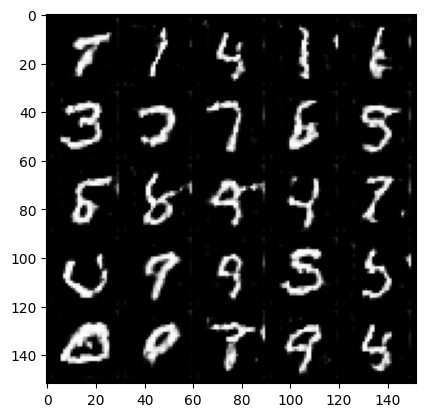

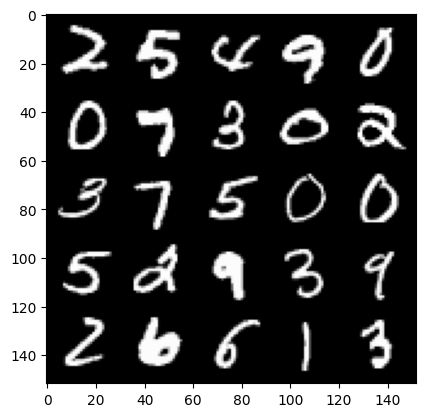

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 105/150 Step 49000 G_loss: 0.693157 D_loss: 0.693159


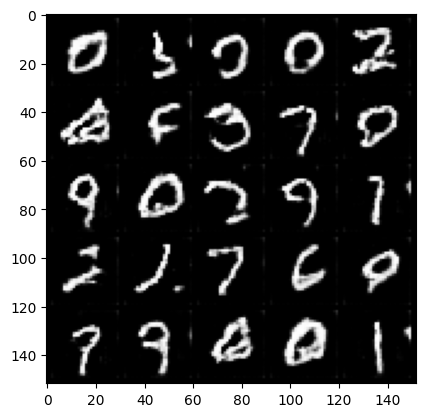

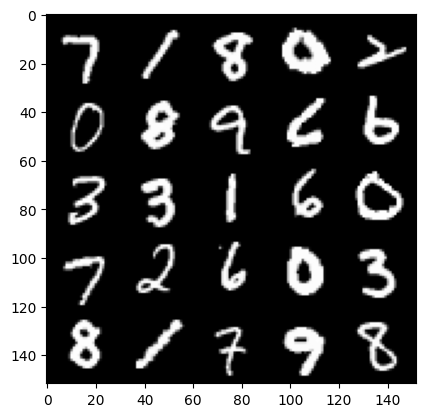

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 106/150 Step 49500 G_loss: 0.693158 D_loss: 0.693160


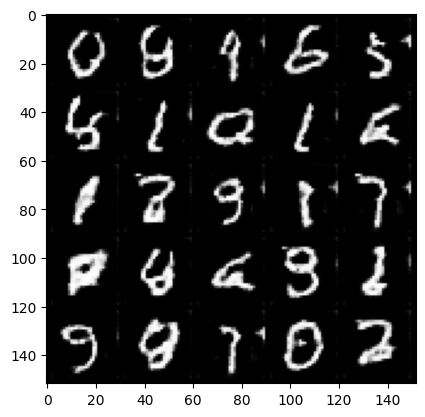

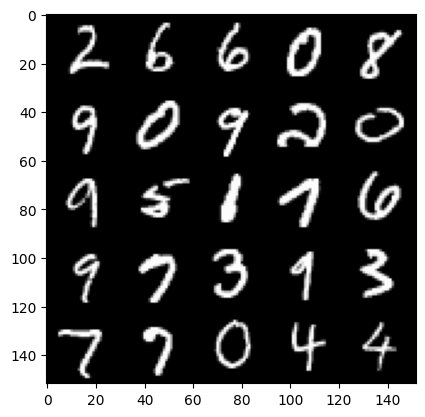

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 107/150 Step 50000 G_loss: 0.693212 D_loss: 0.693175


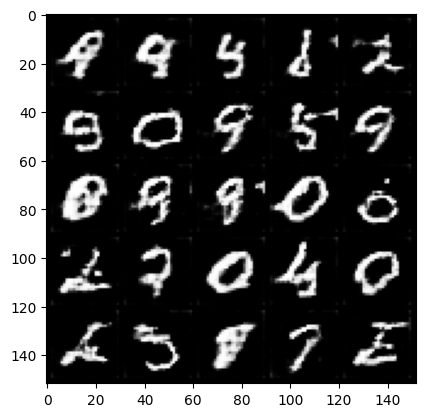

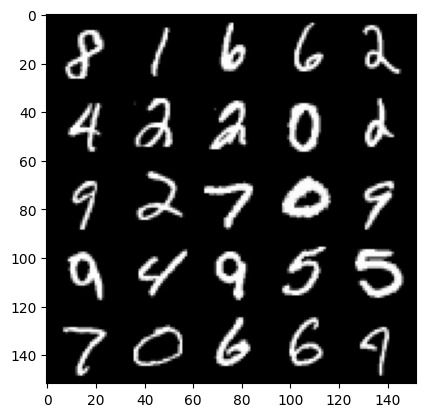

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 108/150 Step 50500 G_loss: 0.693209 D_loss: 0.693162


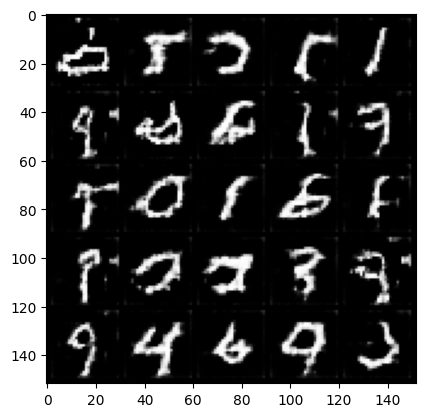

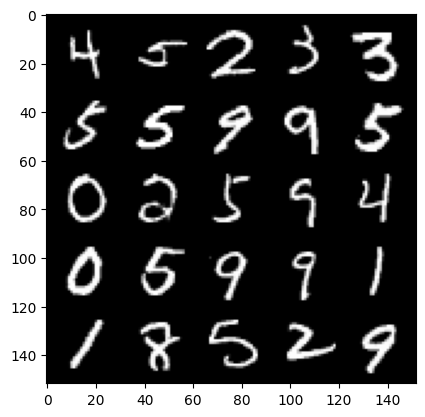

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 109/150 Step 51000 G_loss: 0.693162 D_loss: 0.693158


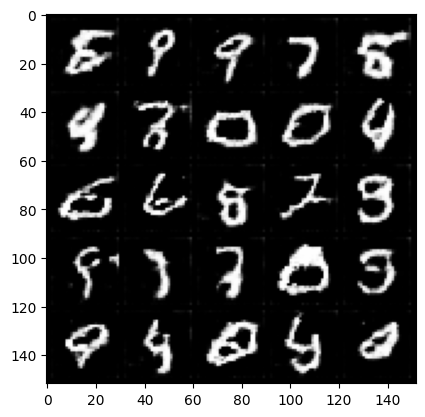

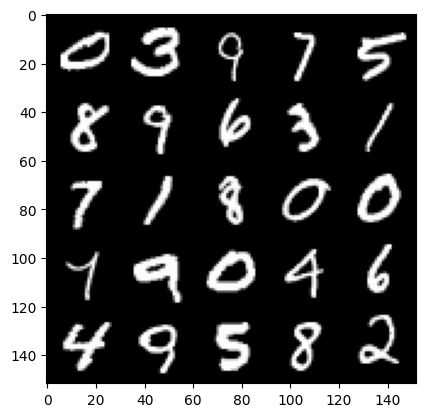

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 110/150 Step 51500 G_loss: 0.693148 D_loss: 0.693159


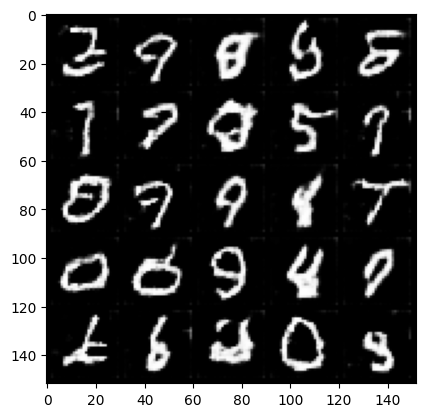

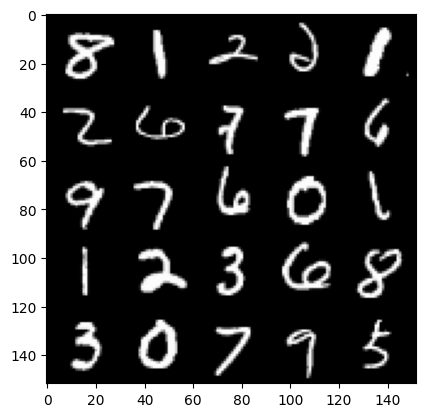

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 111/150 Step 52000 G_loss: 0.693150 D_loss: 0.693154


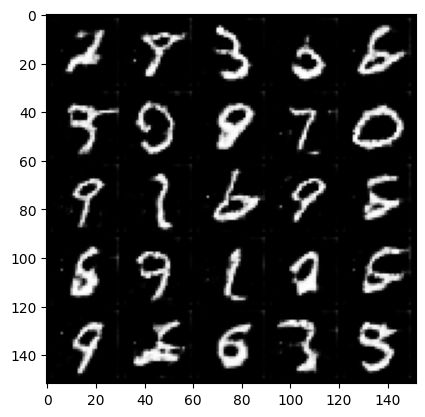

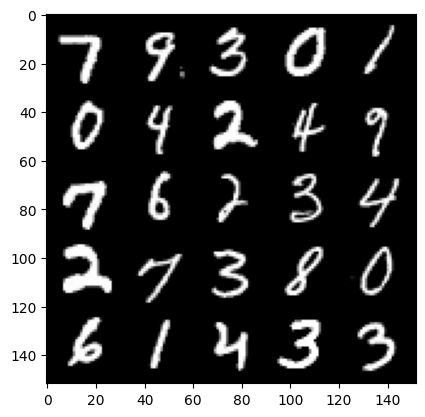

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 112/150 Step 52500 G_loss: 0.693145 D_loss: 0.693155


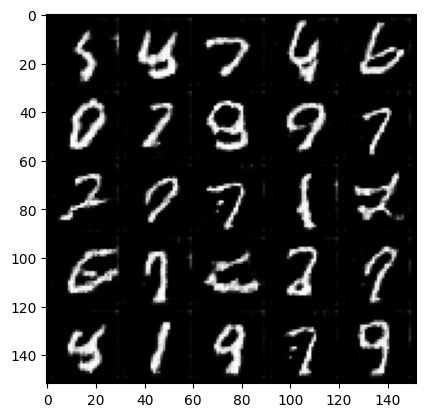

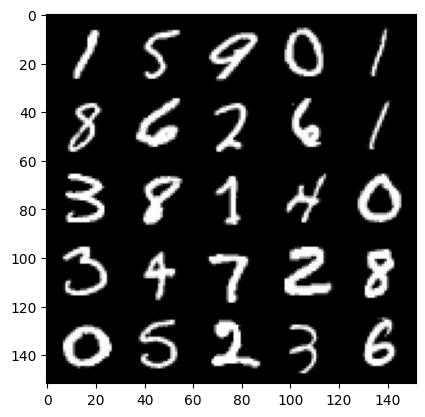

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 114/150 Step 53000 G_loss: 0.693232 D_loss: 0.693163


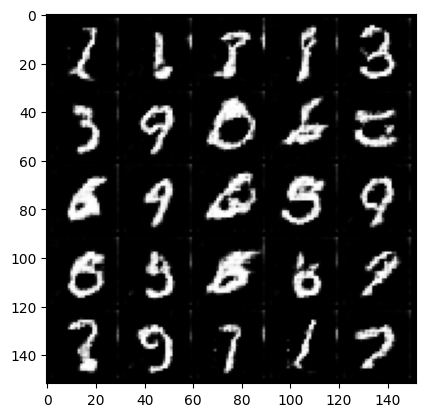

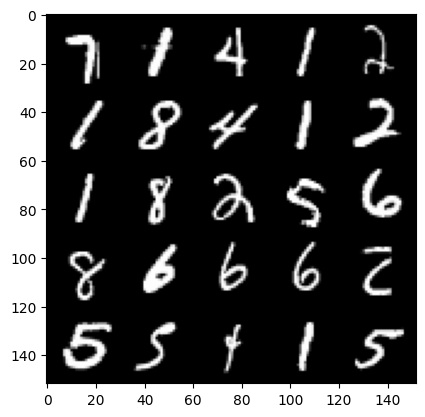

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 115/150 Step 53500 G_loss: 0.693197 D_loss: 0.693173


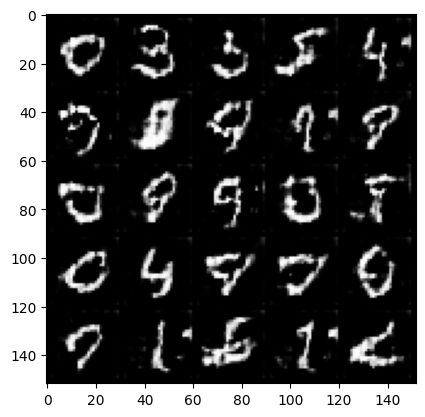

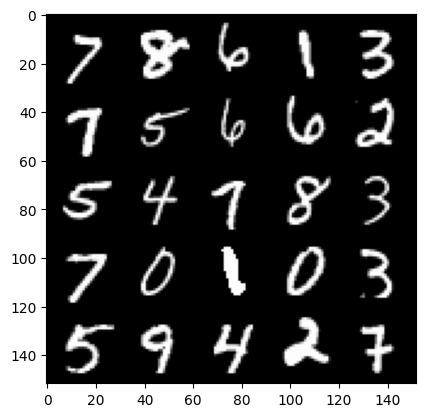

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 116/150 Step 54000 G_loss: 0.693191 D_loss: 0.693168


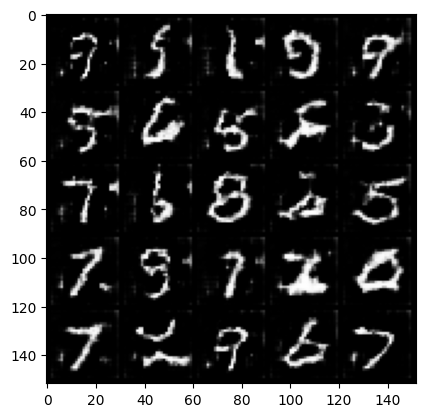

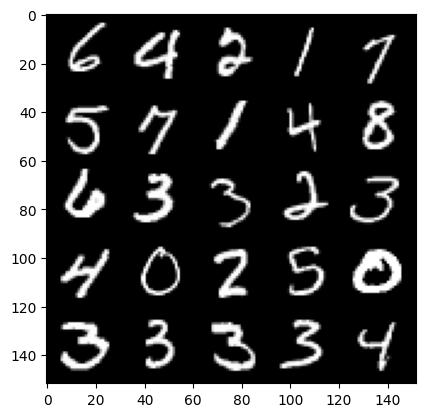

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 117/150 Step 54500 G_loss: 0.693164 D_loss: 0.693161


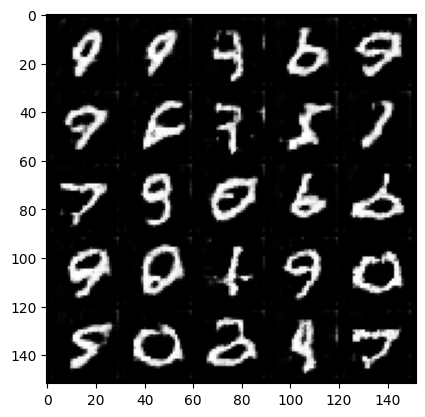

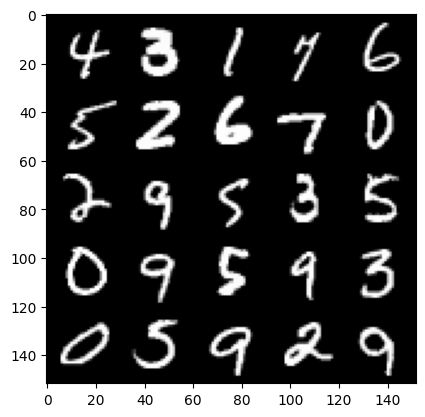

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 118/150 Step 55000 G_loss: 0.693163 D_loss: 0.693162


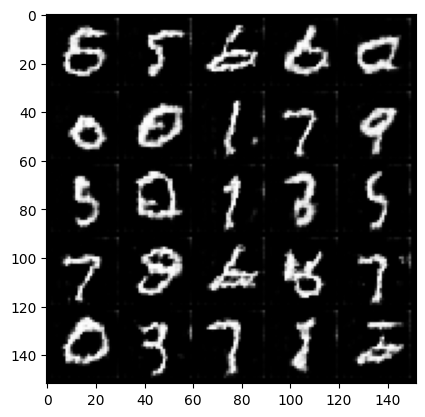

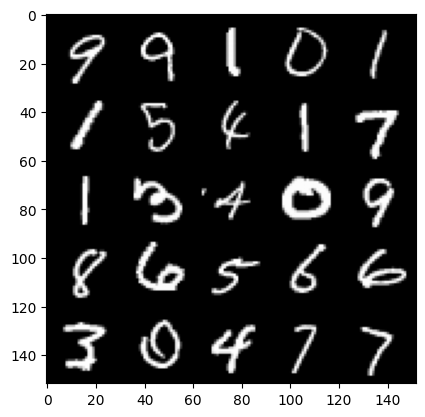

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 119/150 Step 55500 G_loss: 0.693148 D_loss: 0.693154


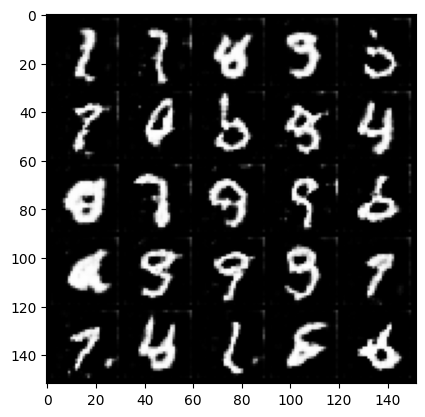

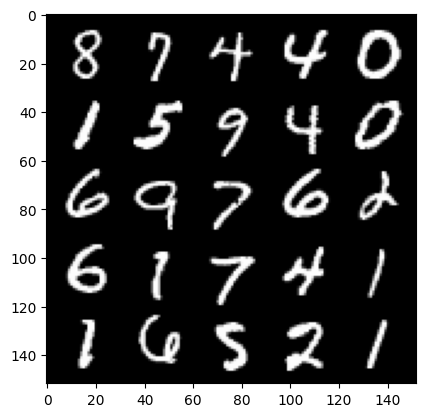

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 120/150 Step 56000 G_loss: 0.693163 D_loss: 0.693160


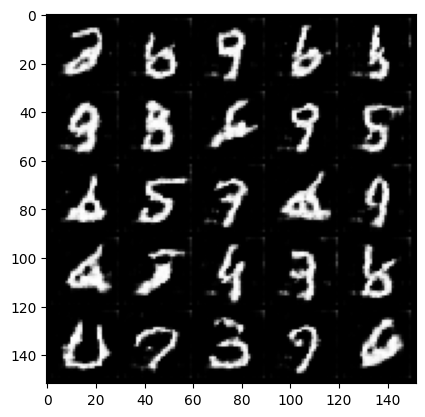

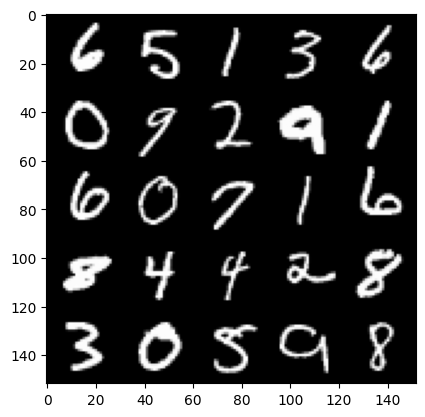

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 121/150 Step 56500 G_loss: 0.693169 D_loss: 0.693156


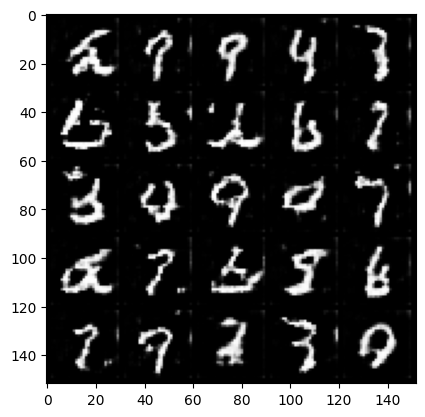

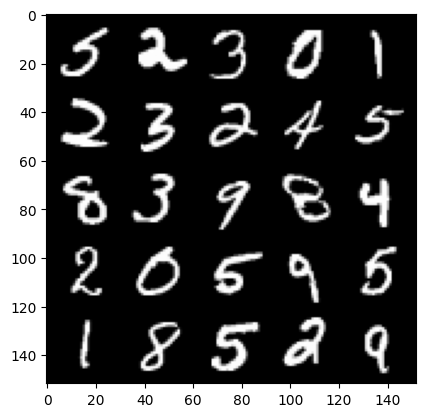

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 122/150 Step 57000 G_loss: 0.693254 D_loss: 0.693175


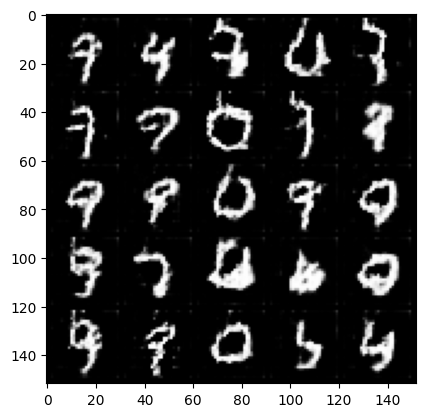

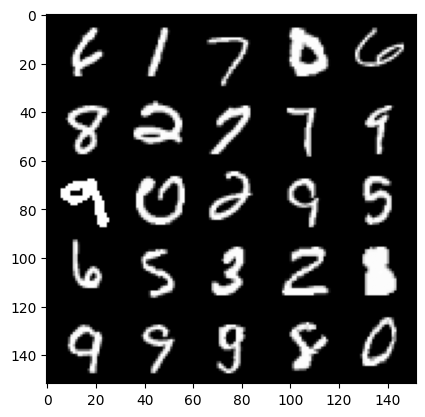

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 123/150 Step 57500 G_loss: 0.693294 D_loss: 0.693183


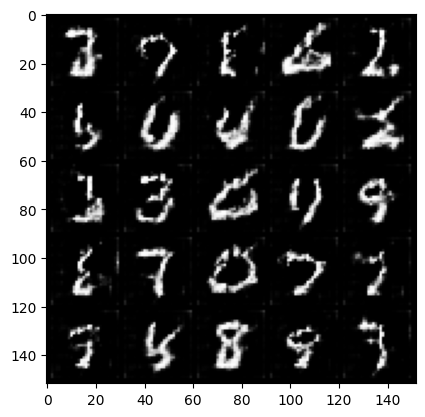

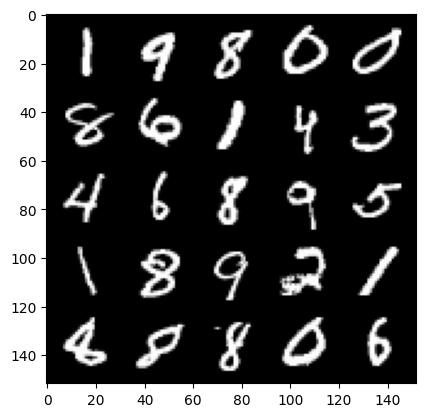

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 124/150 Step 58000 G_loss: 0.693184 D_loss: 0.693178


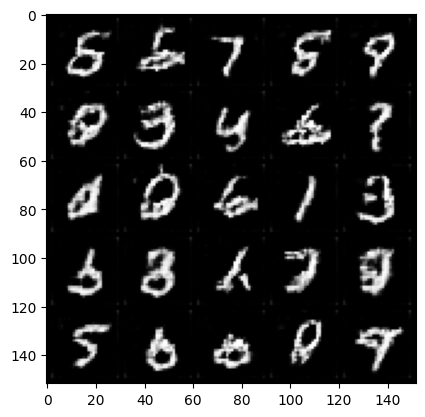

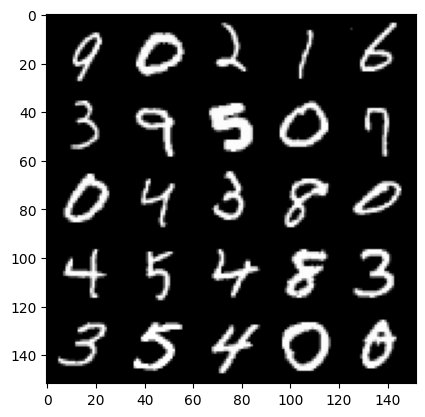

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 125/150 Step 58500 G_loss: 0.693159 D_loss: 0.693161


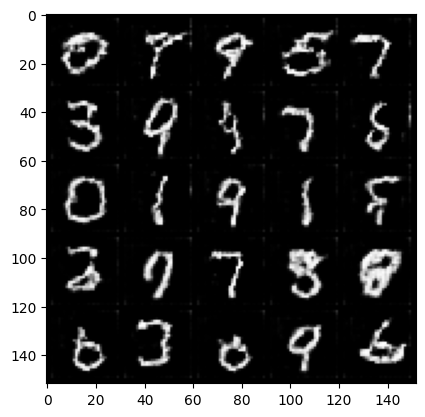

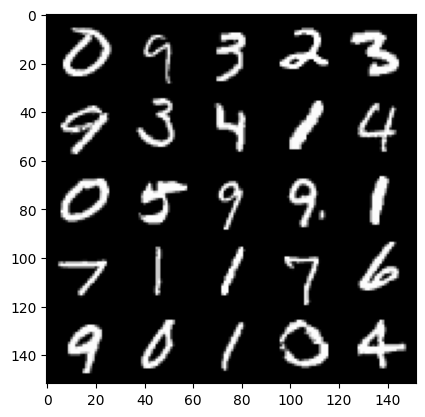

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 126/150 Step 59000 G_loss: 0.693150 D_loss: 0.693152


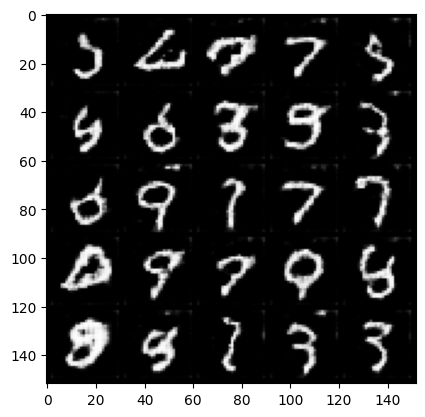

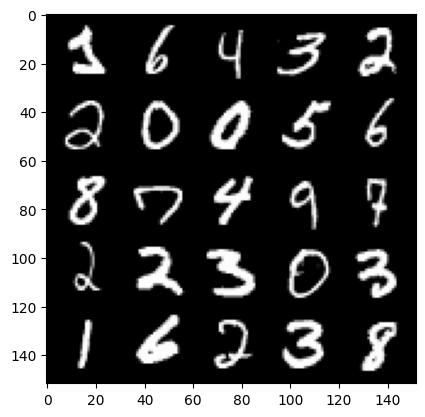

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 127/150 Step 59500 G_loss: 0.693157 D_loss: 0.693156


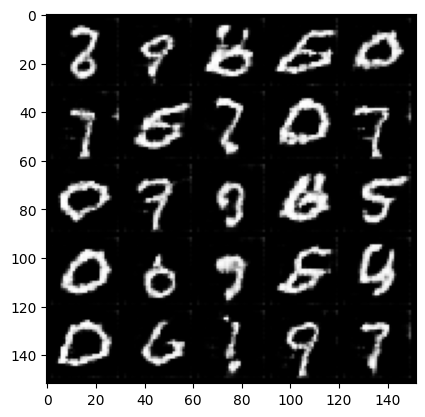

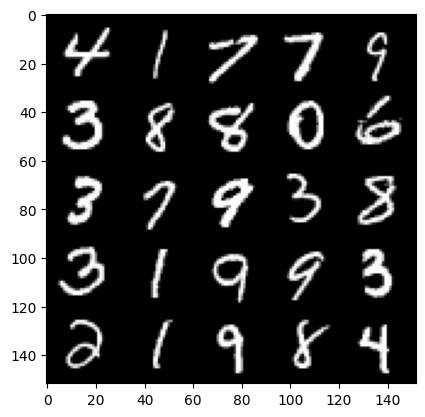

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 128/150 Step 60000 G_loss: 0.693185 D_loss: 0.693162


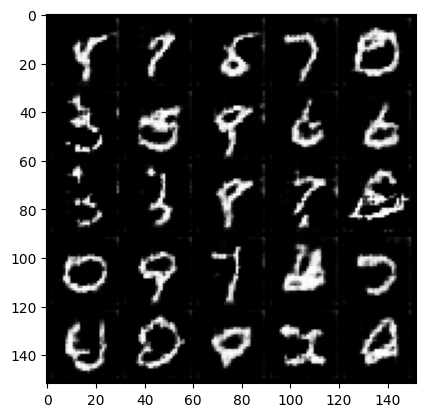

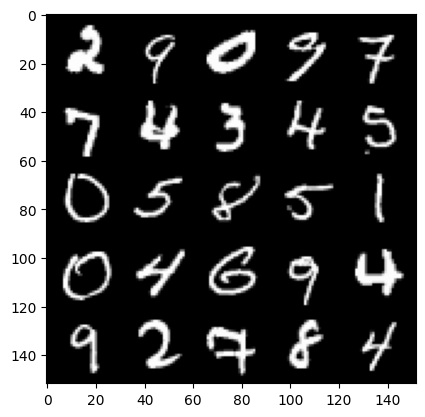

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 129/150 Step 60500 G_loss: 0.693223 D_loss: 0.693169


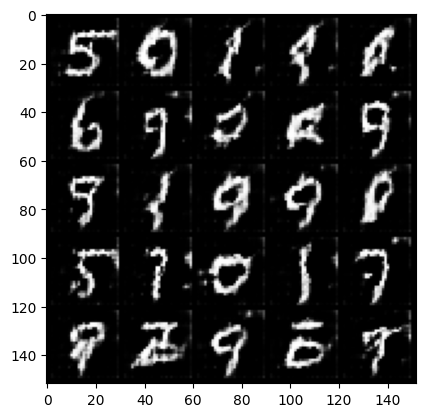

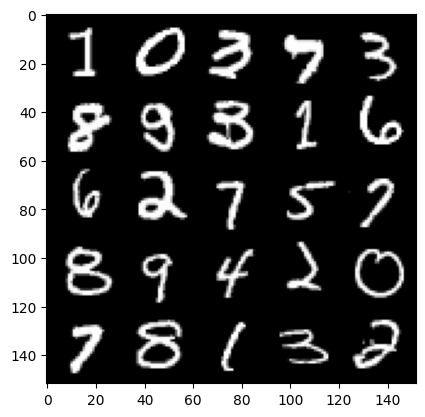

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 131/150 Step 61000 G_loss: 0.693207 D_loss: 0.693175


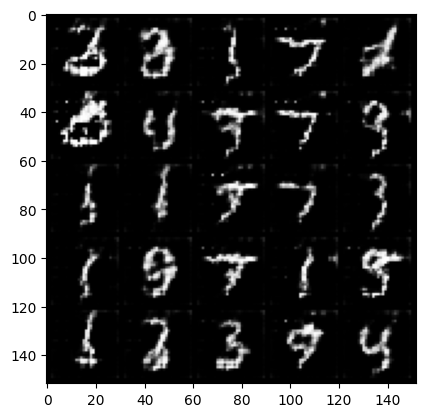

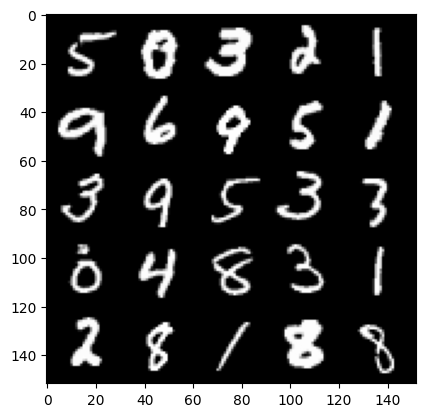

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 132/150 Step 61500 G_loss: 0.693192 D_loss: 0.693163


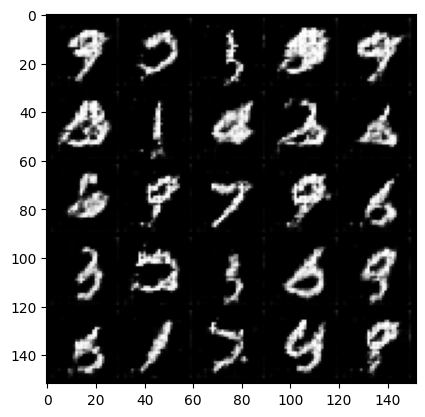

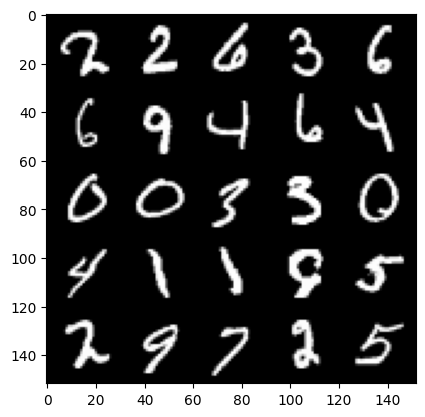

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 133/150 Step 62000 G_loss: 0.693204 D_loss: 0.693172


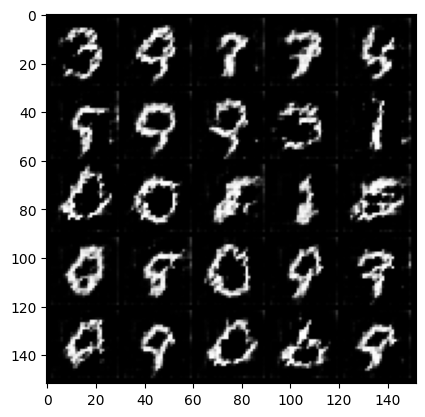

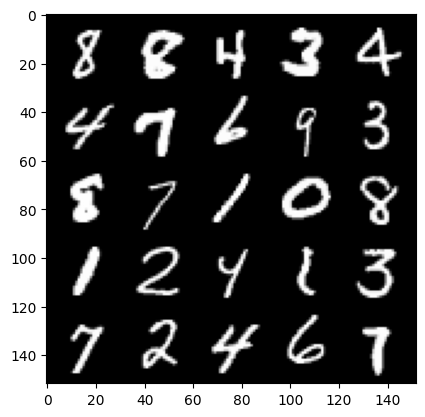

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 134/150 Step 62500 G_loss: 0.693173 D_loss: 0.693158


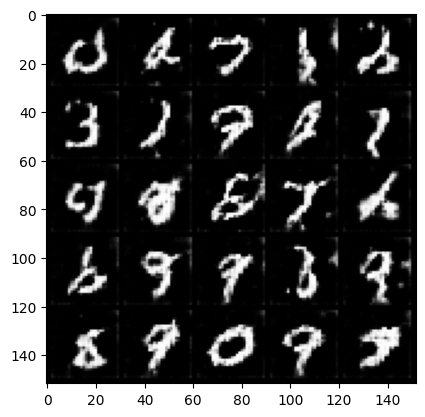

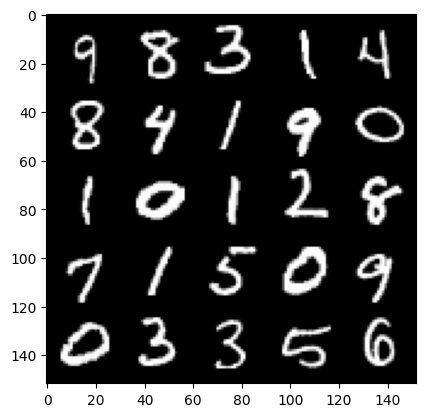

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 135/150 Step 63000 G_loss: 0.693162 D_loss: 0.693169


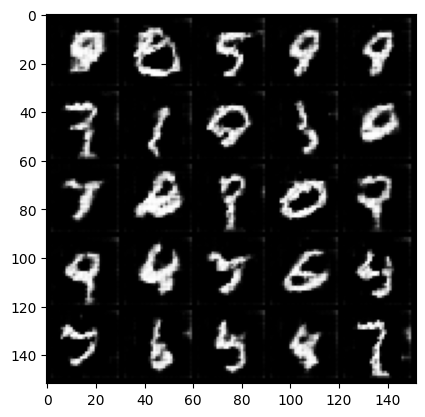

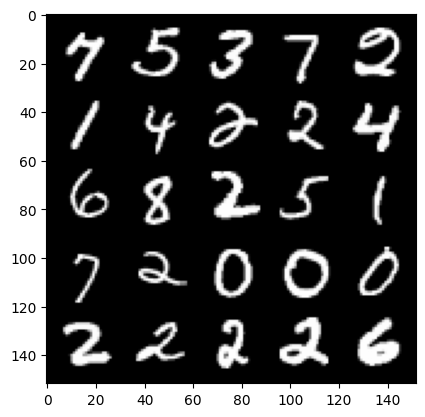

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 136/150 Step 63500 G_loss: 0.693168 D_loss: 0.693157


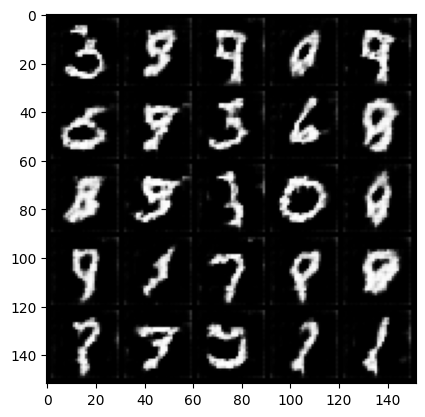

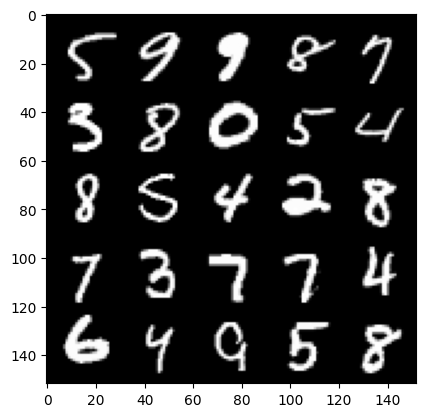

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 137/150 Step 64000 G_loss: 0.693155 D_loss: 0.693157


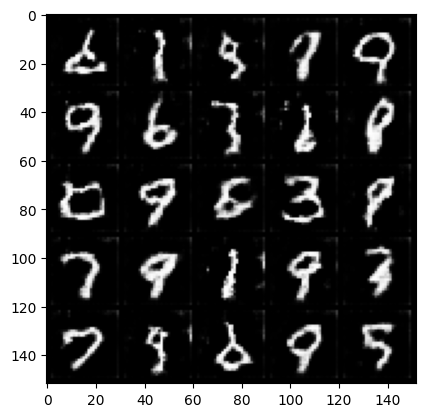

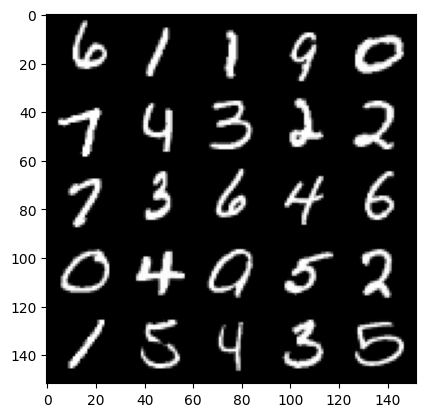

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 138/150 Step 64500 G_loss: 0.693146 D_loss: 0.693159


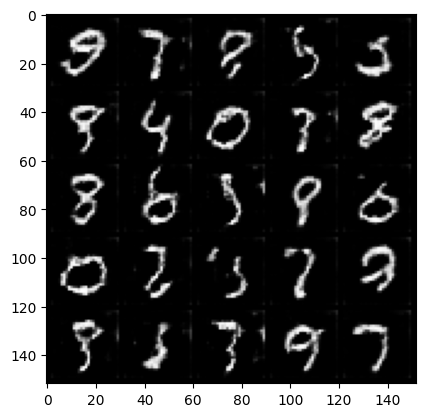

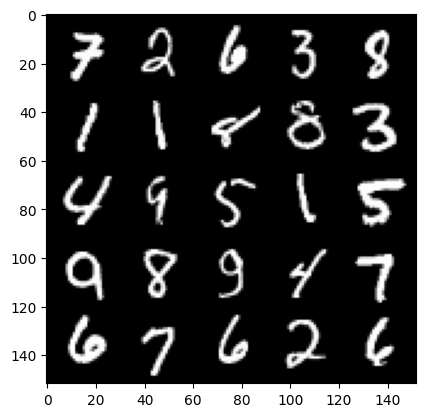

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 139/150 Step 65000 G_loss: 0.693213 D_loss: 0.693173


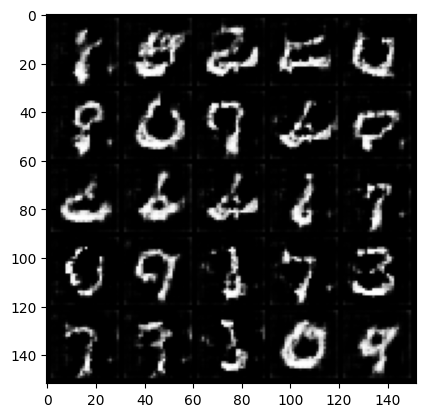

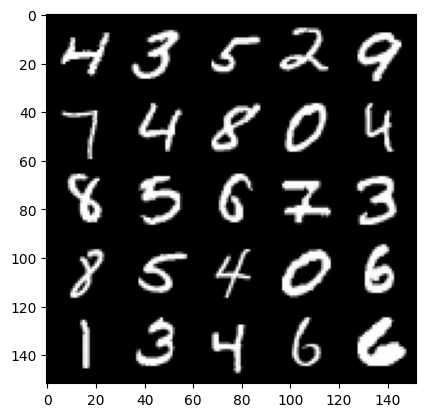

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 140/150 Step 65500 G_loss: 0.693217 D_loss: 0.693171


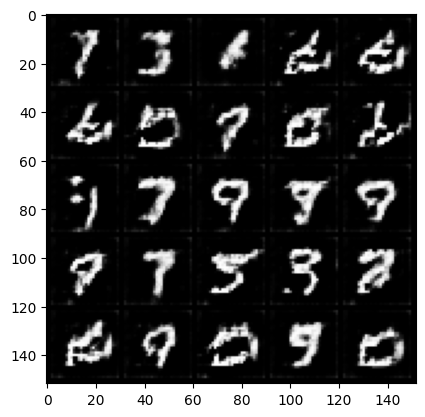

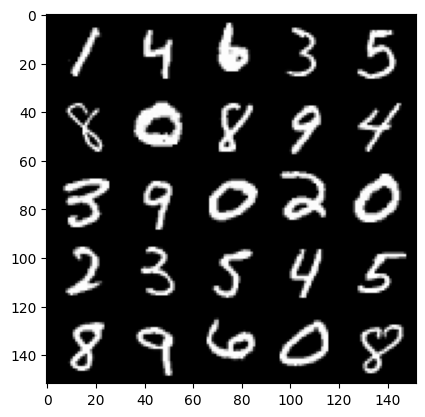

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 141/150 Step 66000 G_loss: 0.693216 D_loss: 0.693171


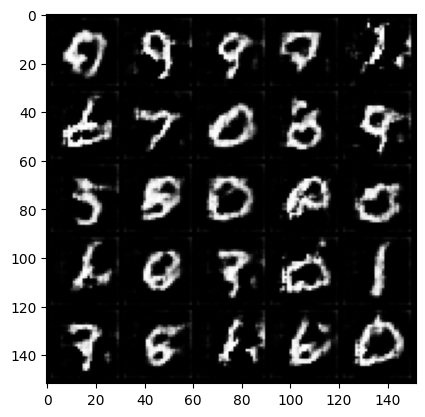

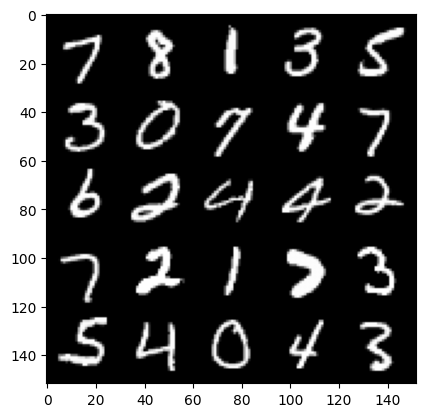

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 142/150 Step 66500 G_loss: 0.693197 D_loss: 0.693156


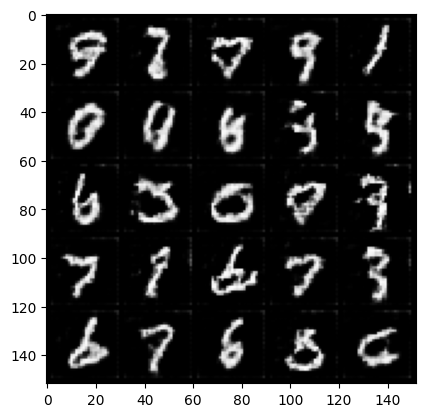

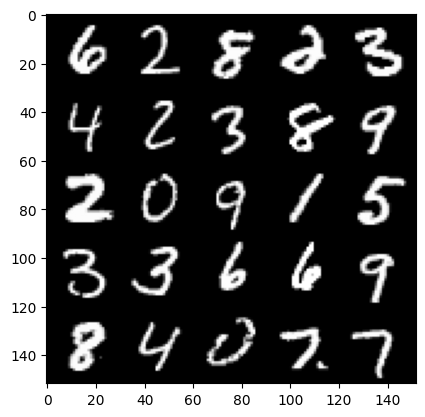

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 143/150 Step 67000 G_loss: 0.693163 D_loss: 0.693160


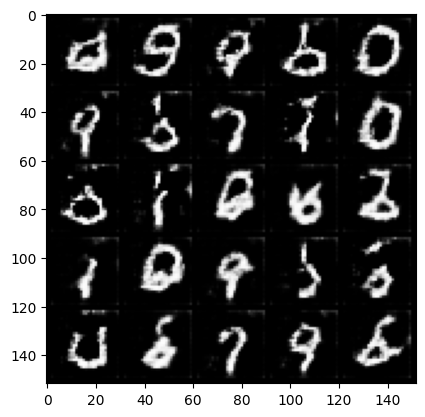

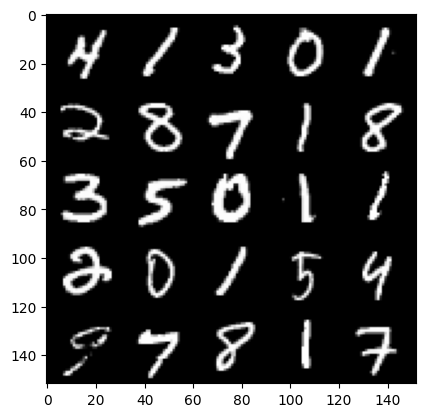

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 144/150 Step 67500 G_loss: 0.693197 D_loss: 0.693158


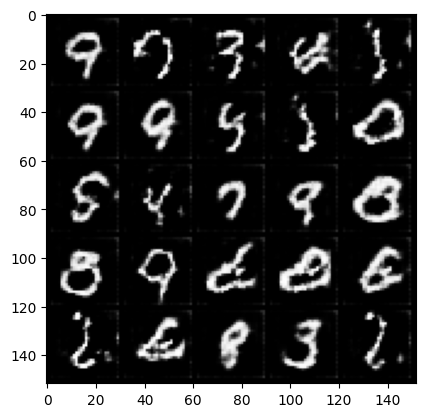

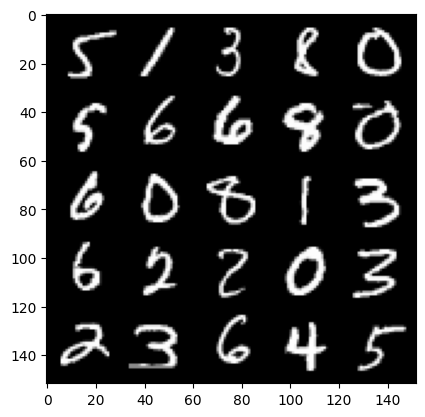

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 145/150 Step 68000 G_loss: 0.693162 D_loss: 0.693161


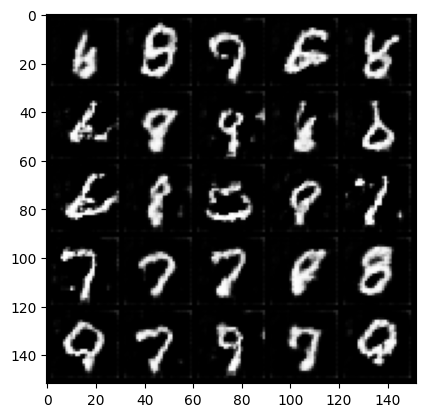

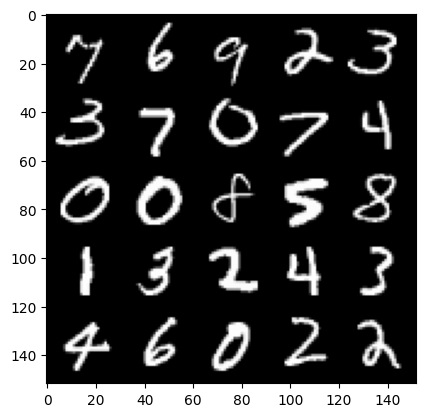

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 147/150 Step 68500 G_loss: 0.693152 D_loss: 0.693156


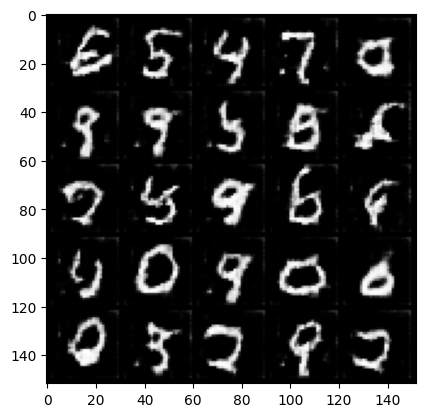

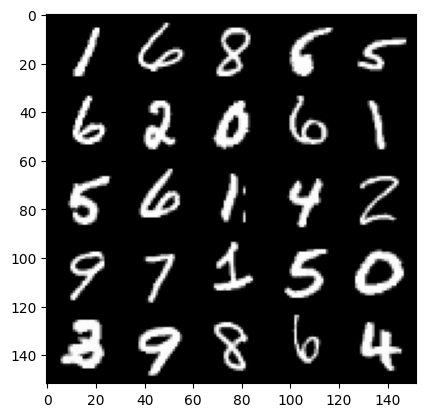

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 148/150 Step 69000 G_loss: 0.693153 D_loss: 0.693157


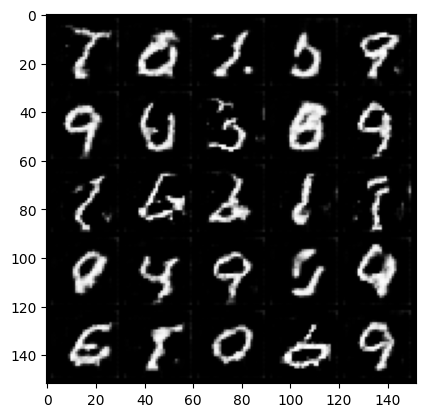

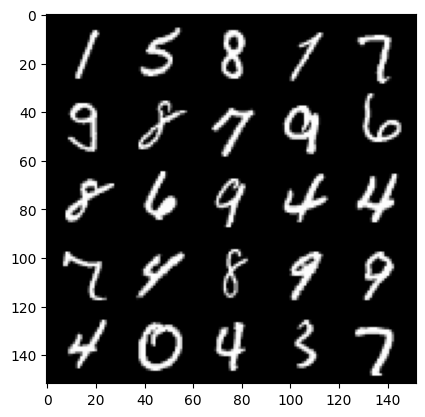

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 149/150 Step 69500 G_loss: 0.693147 D_loss: 0.693154


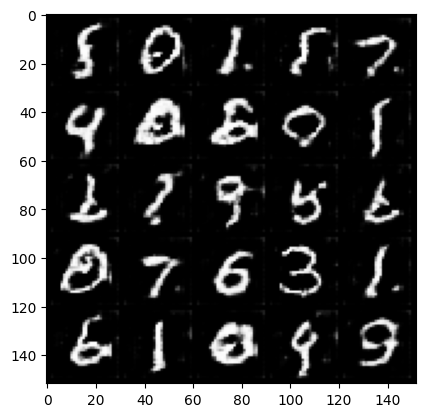

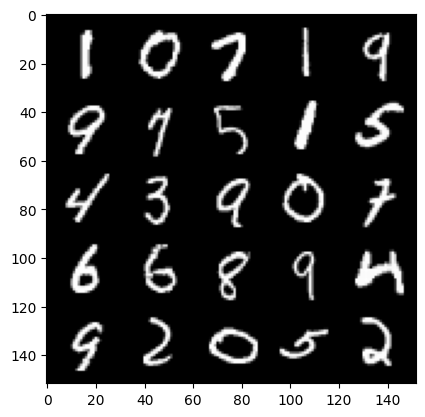

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 150/150 Step 70000 G_loss: 0.693155 D_loss: 0.693156


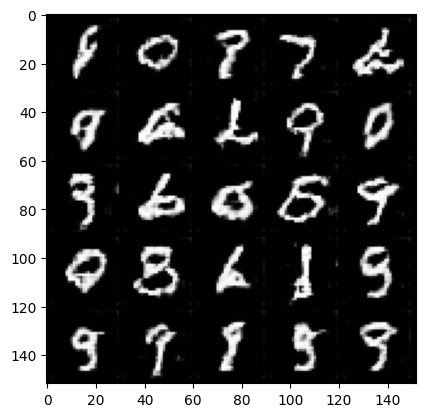

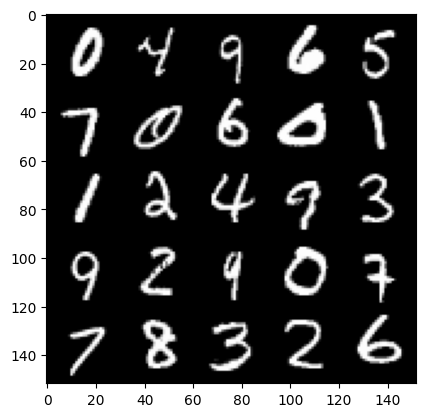

In [13]:
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        ## Update Discriminator ##
        disc_opt.zero_grad()
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        fake = gen(fake_noise)
        disc_fake_pred = disc(fake.detach())
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_pred = disc(real)
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2 # single batch

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step
        
        # Update gradients
        disc_loss.backward(retain_graph=True)
        # Update optimizer
        disc_opt.step()

        ## Update Generator ##
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        disc_fake_pred = disc(fake_2)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ## Visualization code ##
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Epoch {epoch+1}/{n_epochs} Step {cur_step} G_loss: {mean_generator_loss:.6f} D_loss: {mean_discriminator_loss:.6f}")
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1